# **Crops Comodoties Analysis**

### Necessary imports

In [4]:
import pandas as pd 
import matplotlib.pyplot as plt
import plotly
import seaborn as sns
import numpy 
import calendar
import os 
import sys
from termcolor import colored
from datetime import datetime
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.svm import SVC
import mplfinance as mpf

#### directory management and path setting

In [5]:

all_grains_df = pd.read_csv("data//all_grains_data.csv")
corn_df = pd.read_csv(("data//Corn_data.csv"))
wheat_df = pd.read_csv( "data//KC_HRW_Wheat_data.csv")
oat_df = pd.read_csv( ('data//Oat_data.csv'))
rice_df = pd.read_csv( ('data//Rough_Rice_data.csv'))
soybean_df = pd.read_csv( ('data//Soybean_data.csv'))
soybean_oil_df = pd.read_csv( ('data//Soybean_Oil_data.csv'))

dfs_arr = [all_grains_df,corn_df,wheat_df,oat_df,rice_df,soybean_df,soybean_oil_df]
dfs_names_arr = ["all grains","corn",'wheat','oat','rice','soybean','soybean oil']

#### initial inspection

In [6]:
for df in dfs_arr:
    print(df.head(5))
    print("------------------------------------------------------------------------------")

  ticker commodity        date    open    high     low   close  volume
0   ZC=F      Corn  2000-07-17  182.25  182.25  178.25  179.25   19385
1   ZC=F      Corn  2000-07-18  179.00  183.25  179.00  180.75   25205
2   ZC=F      Corn  2000-07-19  180.00  182.75  178.75  182.00   17126
3   ZC=F      Corn  2000-07-20  181.50  187.00  181.00  186.00   18742
4   ZC=F      Corn  2000-07-21  185.50  188.00  185.00  187.75   16814
------------------------------------------------------------------------------
         date    open    high     low   close  volume
0  2000-07-17  182.25  182.25  178.25  179.25   19385
1  2000-07-18  179.00  183.25  179.00  180.75   25205
2  2000-07-19  180.00  182.75  178.75  182.00   17126
3  2000-07-20  181.50  187.00  181.00  186.00   18742
4  2000-07-21  185.50  188.00  185.00  187.75   16814
------------------------------------------------------------------------------
         date   open   high     low   close  volume
0  2000-09-21  296.0  296.0  292.00  293

In [7]:
i = -1 
for df in dfs_arr:
    i+=1
    print(colored(f"{dfs_names_arr[i]}",attrs=['bold']))
    print(colored("***********",attrs=['bold']))
    for n,col in enumerate(list(df.columns)):
        print(f"data type of {col} is {df[col].dtype}")
    print("_______________________________________________________________")
    print("_______________________________________________________________")

all grains
***********
data type of ticker is object
data type of commodity is object
data type of date is object
data type of open is float64
data type of high is float64
data type of low is float64
data type of close is float64
data type of volume is int64
_______________________________________________________________
_______________________________________________________________
corn
***********
data type of date is object
data type of open is float64
data type of high is float64
data type of low is float64
data type of close is float64
data type of volume is int64
_______________________________________________________________
_______________________________________________________________
wheat
***********
data type of date is object
data type of open is float64
data type of high is float64
data type of low is float64
data type of close is float64
data type of volume is int64
_______________________________________________________________
________________________________________

In [8]:
i = -1 
for df in dfs_arr:
    i+=1
    print(colored(f"{dfs_names_arr[i]}",attrs=['bold']))
    print(colored("***********",attrs=['bold']))
    print(f"Number of rows: {df.shape[0]}\nNumber of columns: {df.shape[1]}")
    print("______________________________________________")

all grains
***********
Number of rows: 36041
Number of columns: 8
______________________________________________
corn
***********
Number of rows: 5987
Number of columns: 6
______________________________________________
wheat
***********
Number of rows: 5976
Number of columns: 6
______________________________________________
oat
***********
Number of rows: 5966
Number of columns: 6
______________________________________________
rice
***********
Number of rows: 6130
Number of columns: 6
______________________________________________
soybean
***********
Number of rows: 5979
Number of columns: 6
______________________________________________
soybean oil
***********
Number of rows: 6003
Number of columns: 6
______________________________________________


In [9]:
i = -1 
for df in dfs_arr:
    i+=1
    print(colored(f"{dfs_names_arr[i]}",attrs=['bold']))
    print(colored("***********",attrs=['bold']))
    print(df.isna().sum())
    print("______________________________________________")

all grains
***********
ticker       0
commodity    0
date         0
open         0
high         0
low          0
close        0
volume       0
dtype: int64
______________________________________________
corn
***********
date      0
open      0
high      0
low       0
close     0
volume    0
dtype: int64
______________________________________________
wheat
***********
date      0
open      0
high      0
low       0
close     0
volume    0
dtype: int64
______________________________________________
oat
***********
date      0
open      0
high      0
low       0
close     0
volume    0
dtype: int64
______________________________________________
rice
***********
date      0
open      0
high      0
low       0
close     0
volume    0
dtype: int64
______________________________________________
soybean
***********
date      0
open      0
high      0
low       0
close     0
volume    0
dtype: int64
______________________________________________
soybean oil
***********
date      0
open      0
h

In [10]:
i = -1 
for df in dfs_arr:
    i+=1
    max_value_row = df.loc[df['high'].idxmax()]
    print(colored(f"{dfs_names_arr[i]}",attrs=['bold']))
    print(colored("***********",attrs=['bold']))
    print(f"Highest high of the whole time: {max_value_row['high']}\nDate of highest high: {max_value_row['date']}")
    print("______________________________________________")

all grains
***********
Highest high of the whole time: 2468.5
Date of highest high: 2008-04-24
______________________________________________
corn
***********
Highest high of the whole time: 843.75
Date of highest high: 2012-08-10
______________________________________________
wheat
***********
Highest high of the whole time: 1384.75
Date of highest high: 2008-02-27
______________________________________________
oat
***********
Highest high of the whole time: 811.0
Date of highest high: 2022-04-12
______________________________________________
rice
***********
Highest high of the whole time: 2468.5
Date of highest high: 2008-04-24
______________________________________________
soybean
***********
Highest high of the whole time: 1794.75
Date of highest high: 2012-09-04
______________________________________________
soybean oil
***********
Highest high of the whole time: 91.4000015258789
Date of highest high: 2022-04-29
______________________________________________


In [11]:
i = -1 
for df in dfs_arr:
    i+=1
    max_value_row = df.loc[df['low'].idxmax()]
    print(colored(f"{dfs_names_arr[i]}",attrs=['bold']))
    print(colored("***********",attrs=['bold']))
    print(f"lowest low of the whole time: {max_value_row['low']}\nDate of lowest low: {max_value_row['date']}")
    print("______________________________________________")

all grains
***********
lowest low of the whole time: 2400.0
Date of lowest low: 2008-04-23
______________________________________________
corn
***********
lowest low of the whole time: 822.75
Date of lowest low: 2012-08-22
______________________________________________
wheat
***********
lowest low of the whole time: 1325.0
Date of lowest low: 2022-05-16
______________________________________________
oat
***********
lowest low of the whole time: 799.75
Date of lowest low: 2022-04-12
______________________________________________
rice
***********
lowest low of the whole time: 2400.0
Date of lowest low: 2008-04-23
______________________________________________
soybean
***********
lowest low of the whole time: 1760.5
Date of lowest low: 2012-09-04
______________________________________________
soybean oil
***********
lowest low of the whole time: 89.0999984741211
Date of lowest low: 2022-04-29
______________________________________________


In [12]:
for df in dfs_arr:
    df['date'] = pd.to_datetime(df['date'],format="%Y-%m-%d")

In [13]:
plt.style.use("ggplot")

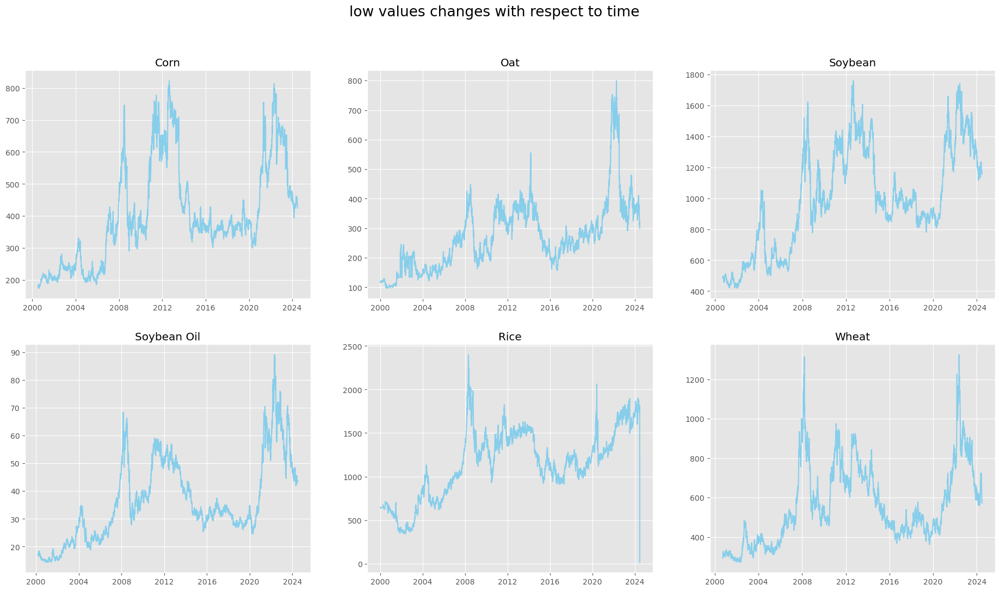

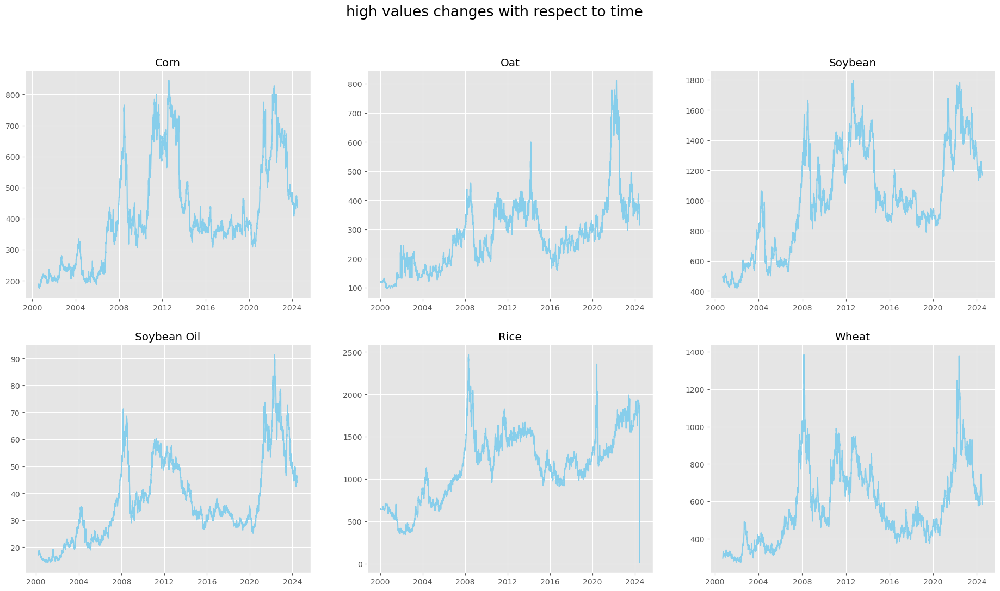

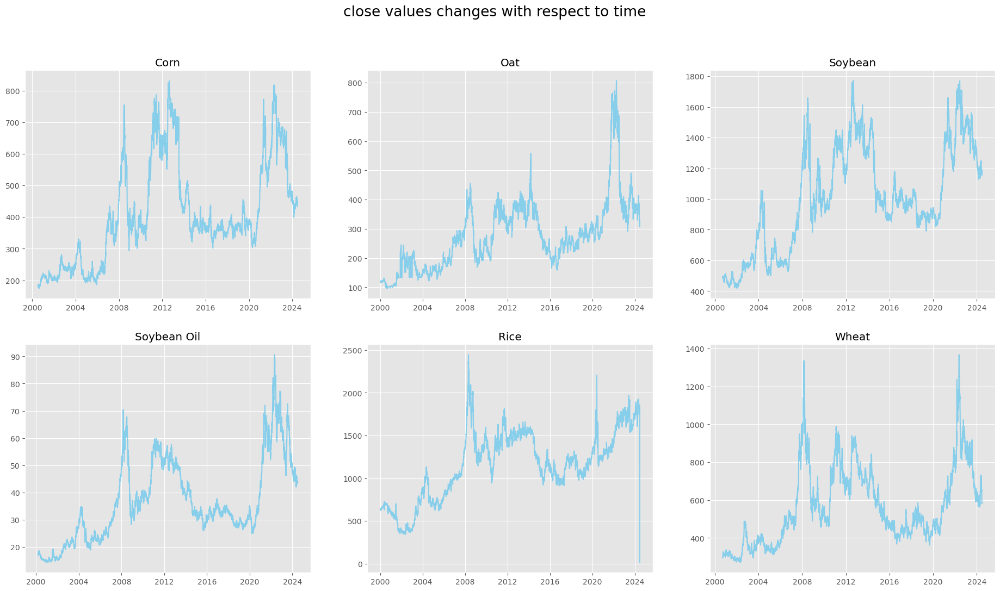

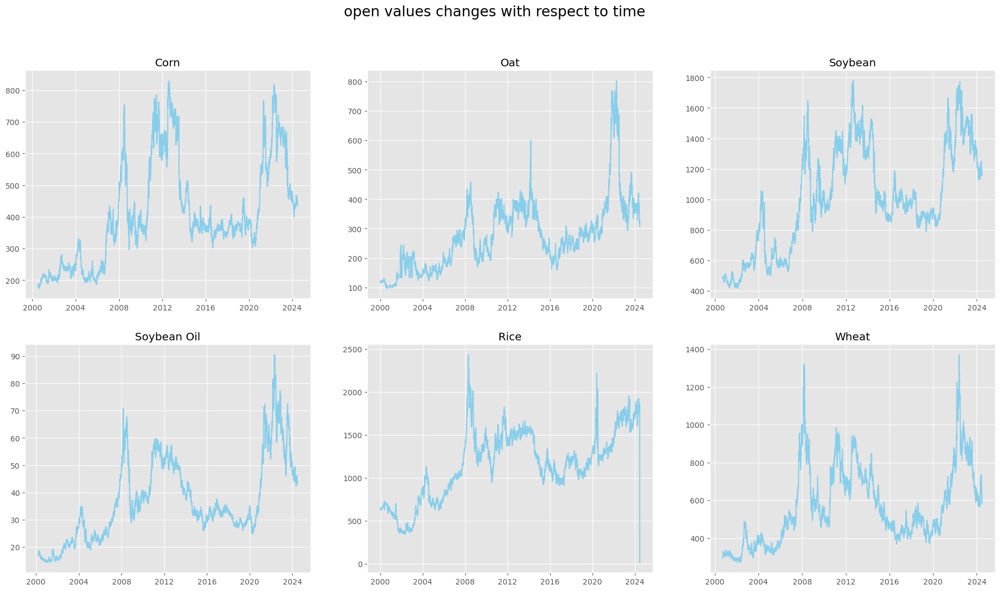

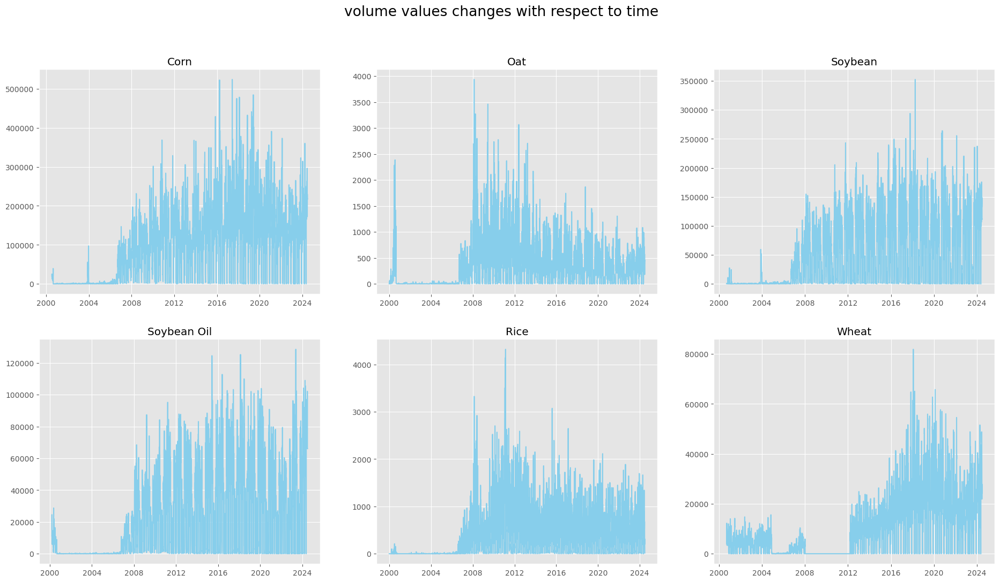

In [14]:
splitted_dfs = [corn_df,oat_df,soybean_df,soybean_oil_df,rice_df,wheat_df]
titles_names = ['Corn','Oat','Soybean','Soybean Oil','Rice','Wheat']

def plot_variable_all_dfs(name:str) -> None:    
    fig,ax = plt.subplots(figsize = (23,12),nrows=2,ncols=3)
    fig.suptitle(f"{name} values changes with respect to time",fontsize = 19)
    counter = 0
    for i in range(2):
        for j in range(3):
            ax[i][j].plot(splitted_dfs[counter]['date'],splitted_dfs[counter][name],color='skyblue')
            ax[i][j].set_title(titles_names[counter])
            counter+=1

plot_variable_all_dfs('low')
plot_variable_all_dfs('high')
plot_variable_all_dfs('close')
plot_variable_all_dfs('open')
plot_variable_all_dfs('volume')

In [15]:
for df in splitted_dfs:
    df.set_index('date',inplace=True)


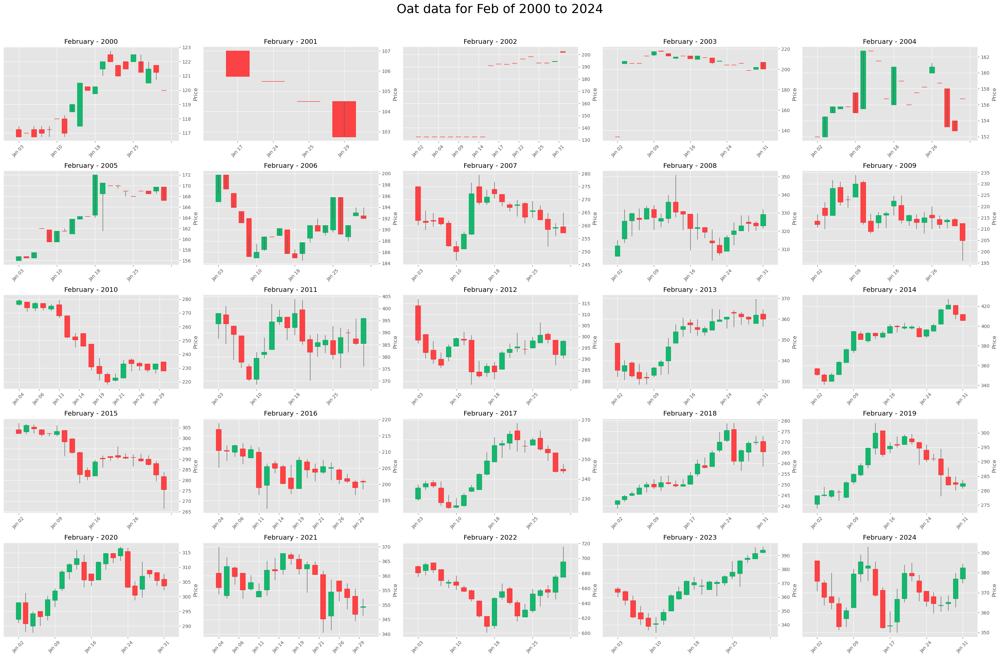

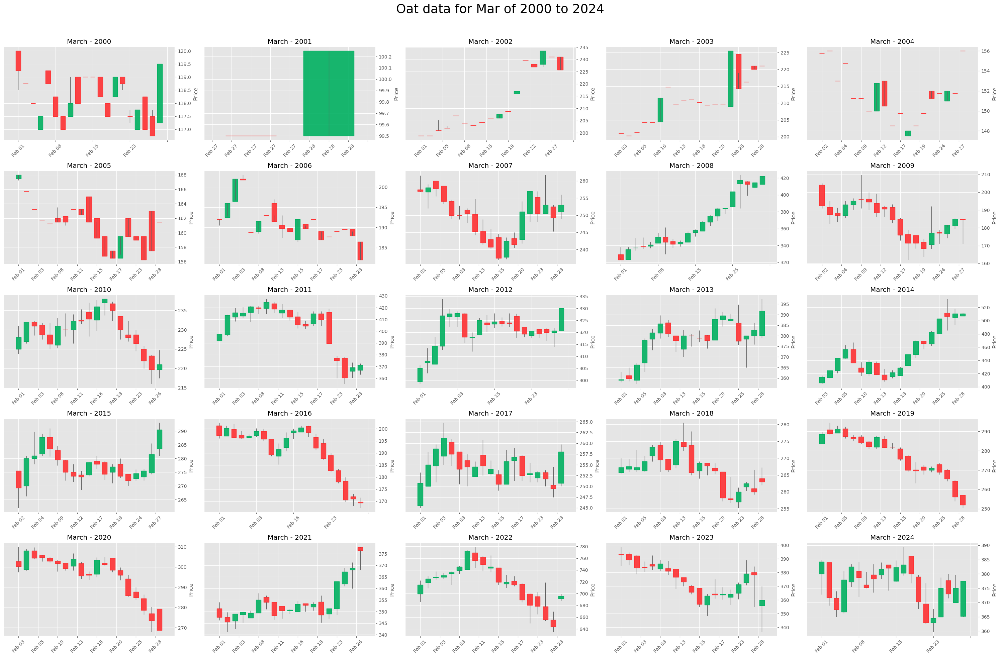

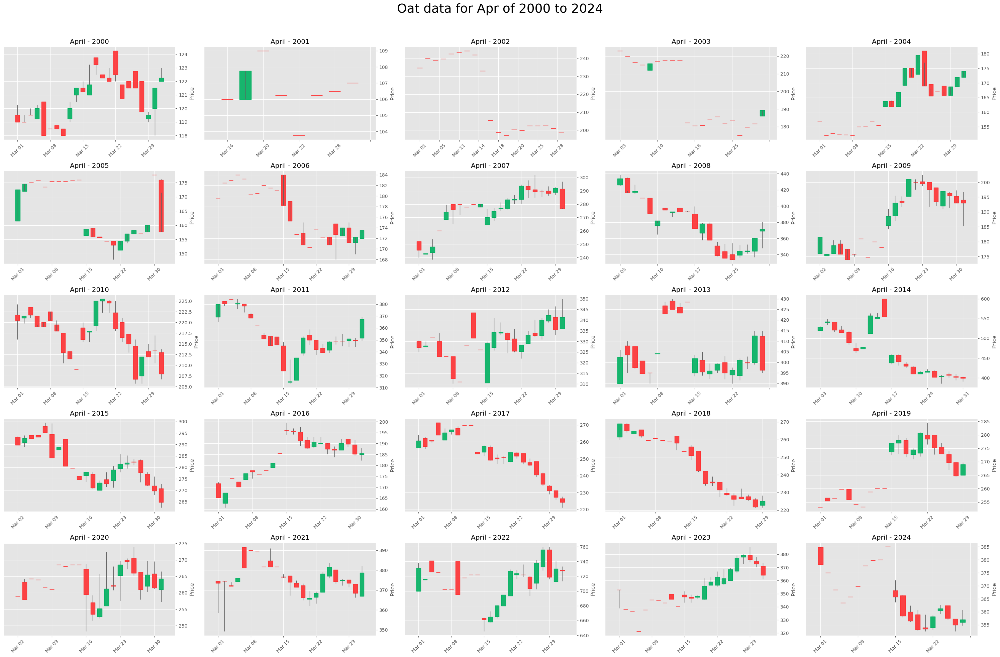

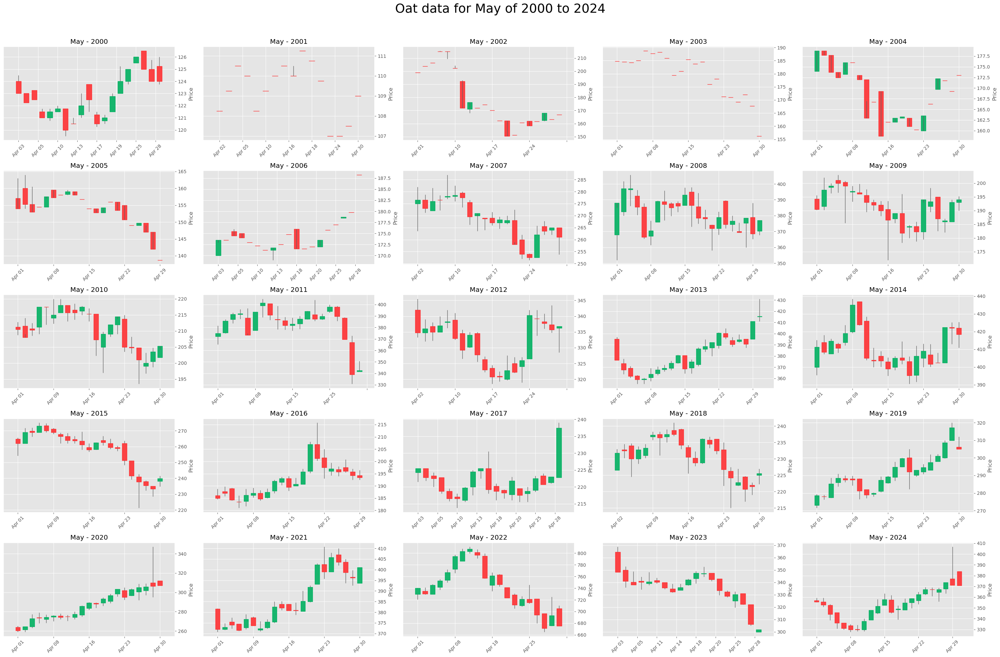

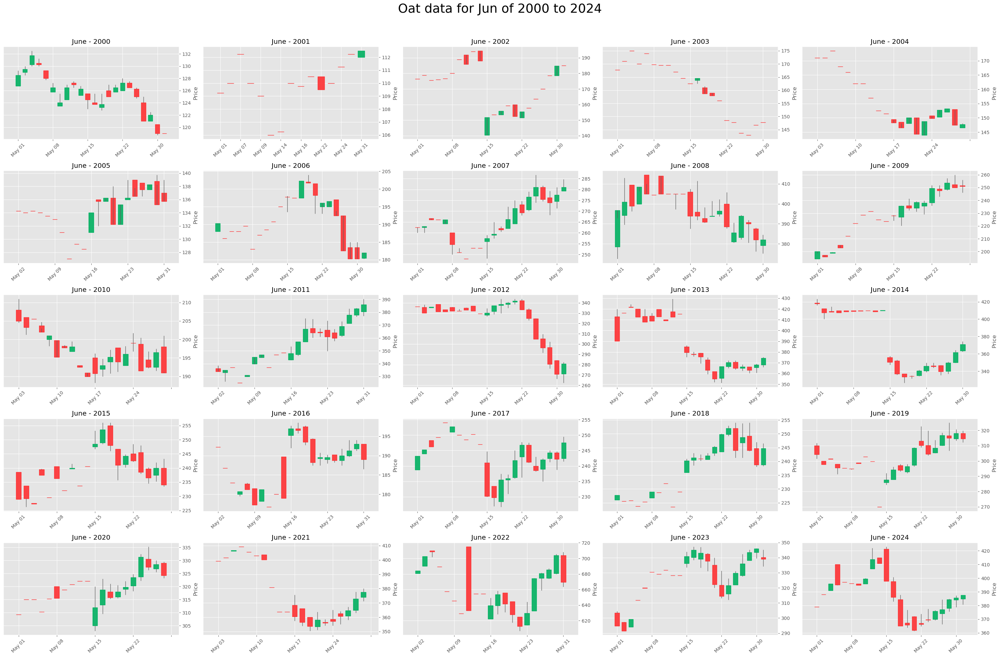

...

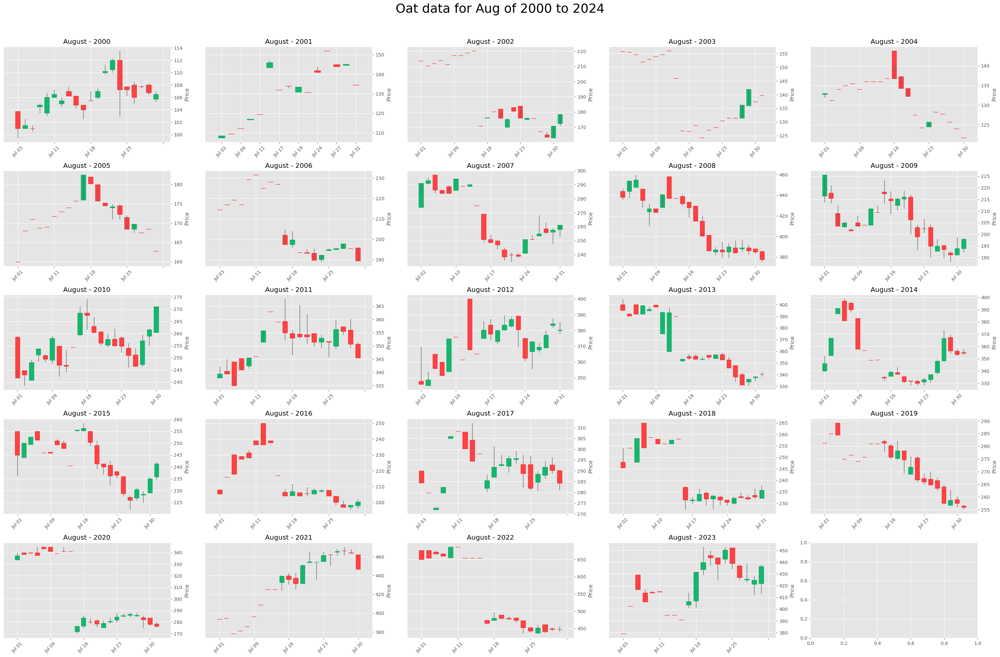

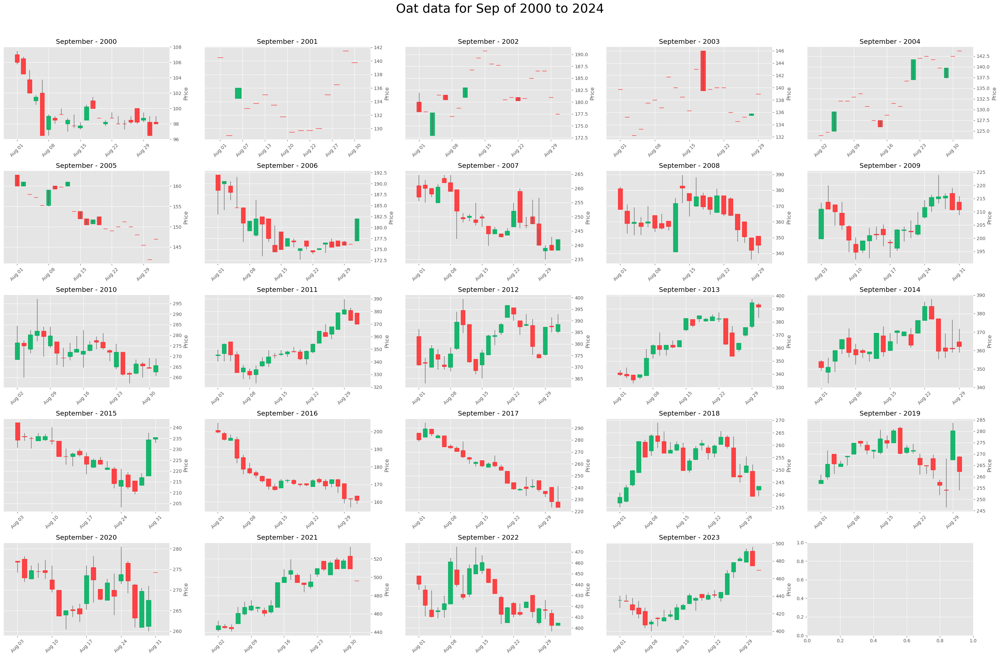

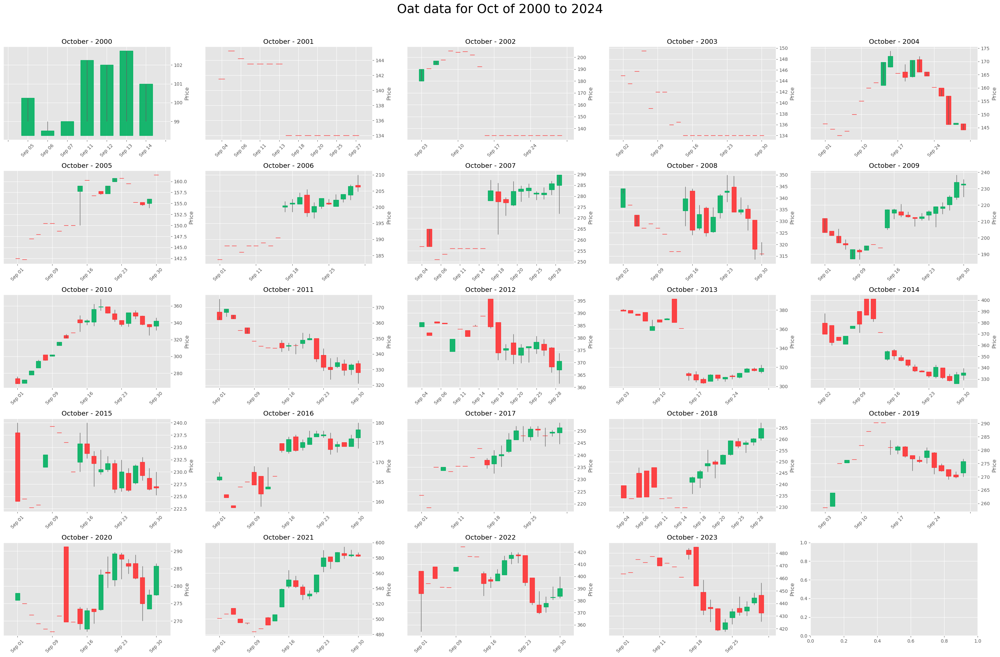

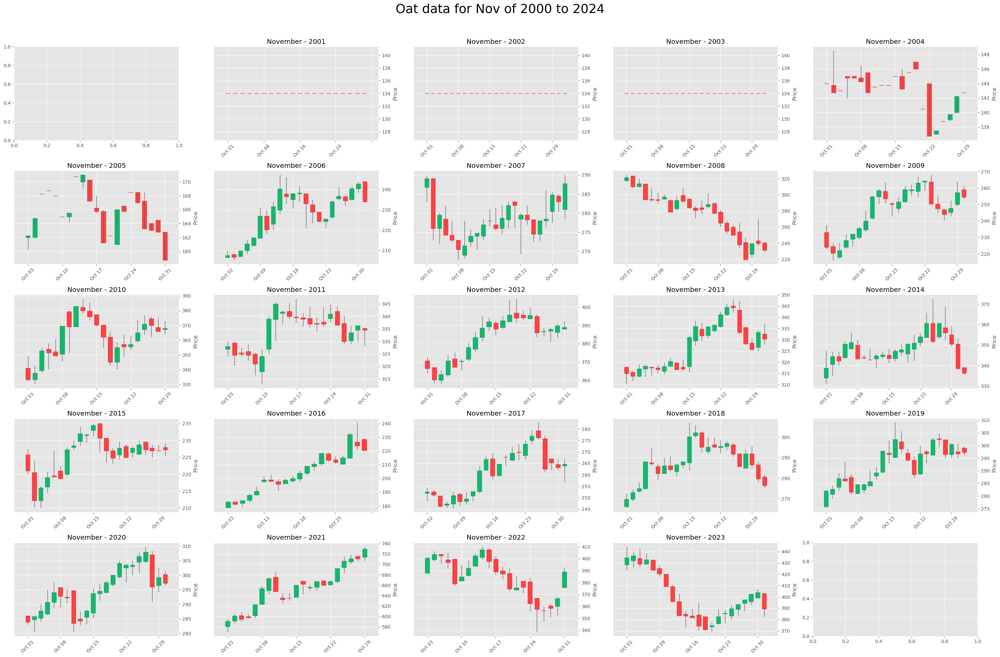

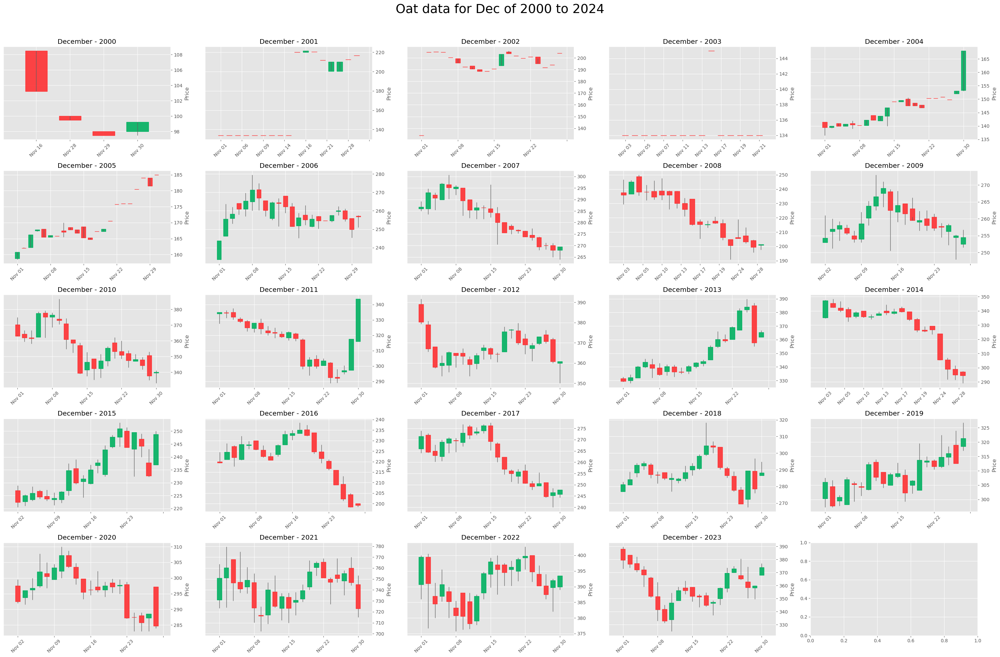

In [16]:


def plotter_sub_plots(df, month,df_name,month_name):
        
    rows = 5
    cols = 5
    months = {i: calendar.month_abbr[i + 1] for i in range(12)}
    fig, axes = plt.subplots(rows, cols, figsize=(30, 20))  
    fig.suptitle(f'{df_name} data for {months[month]} of 2000 to 2024', fontsize=27)  

    axes = axes.flatten()

    for i, year in enumerate(oat_df.index.year.unique()):
        df_month = df[(df.index.month == month) & (df.index.year == year)]
        
        if not df_month.empty:
            mpf.plot(df_month, 
                    type='candle', 
                    style='yahoo', 
                    ax=axes[i])  
            axes[i].set_title(f'{month_name} - {year}')  

        
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout(rect=[0, 0, 1, 0.96])  
    plt.show()

months = [
    "January",
    "February",
    "March",
    "April",
    "May",
    "June",
    "July",
    "August",
    "September",
    "October",
    "November",
    "December"
]

for i in range(len(months)-1):
    plotter_sub_plots(oat_df,i+1,"Oat",months[i+1])
    
    

In [17]:
wheat_df[wheat_df.index.year == 2022].index.month.unique()

Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12], dtype='int32', name='date')

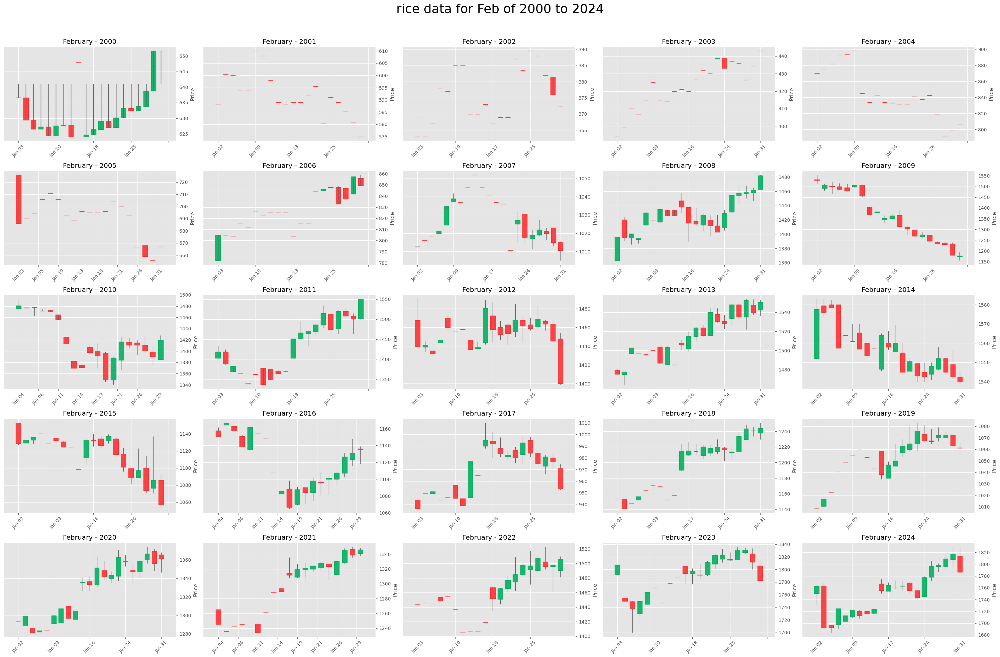

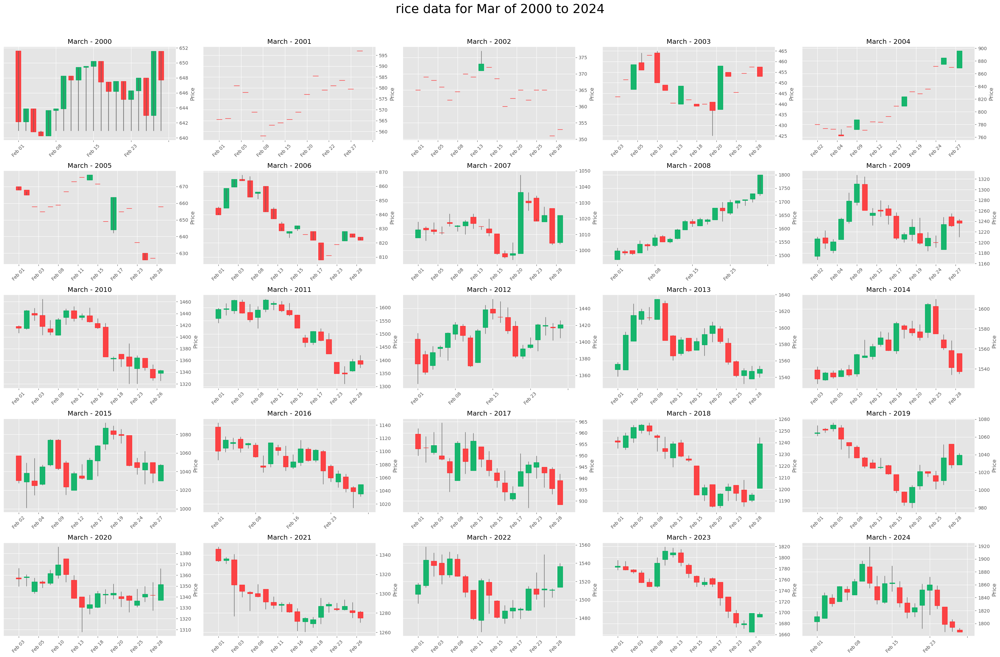

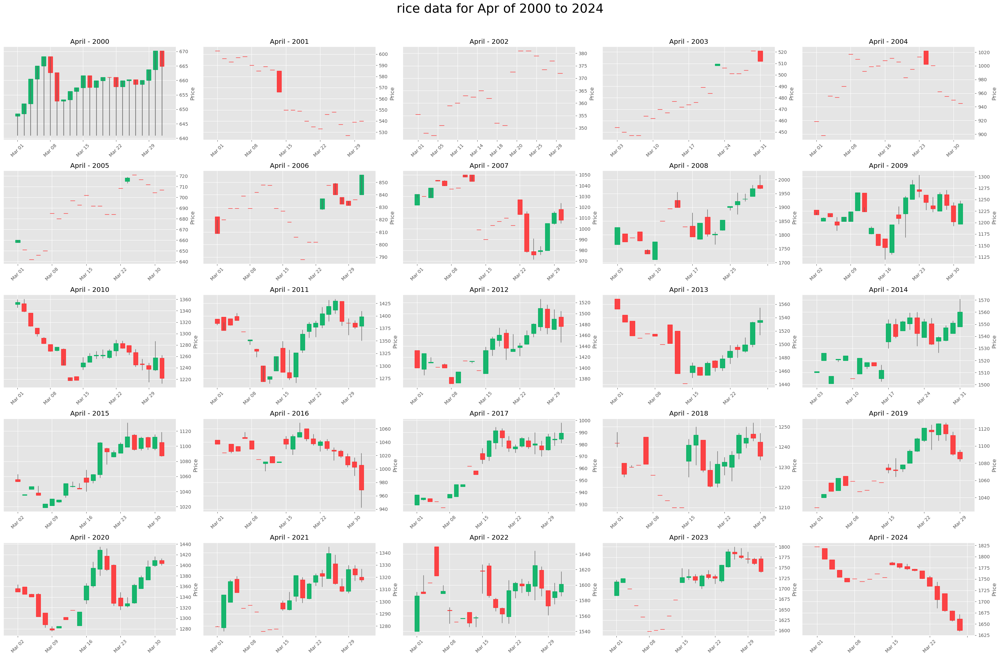

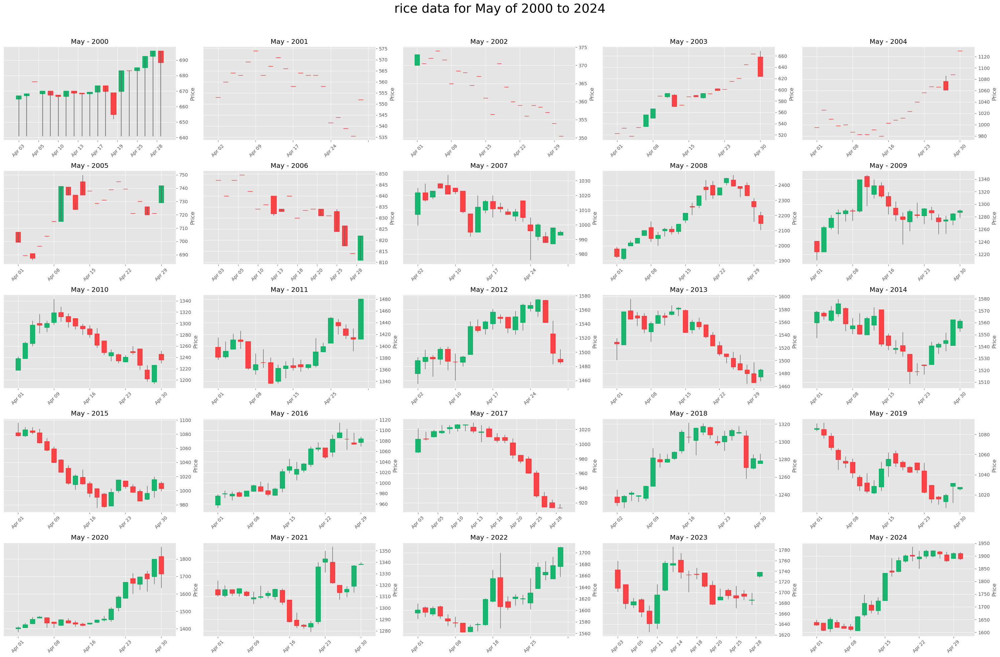

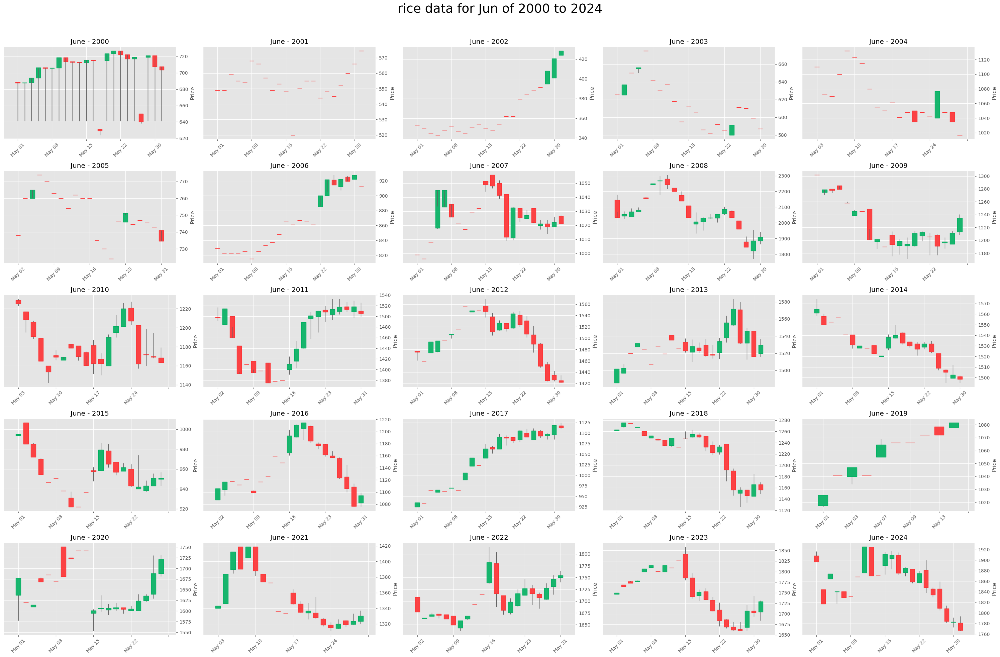

...

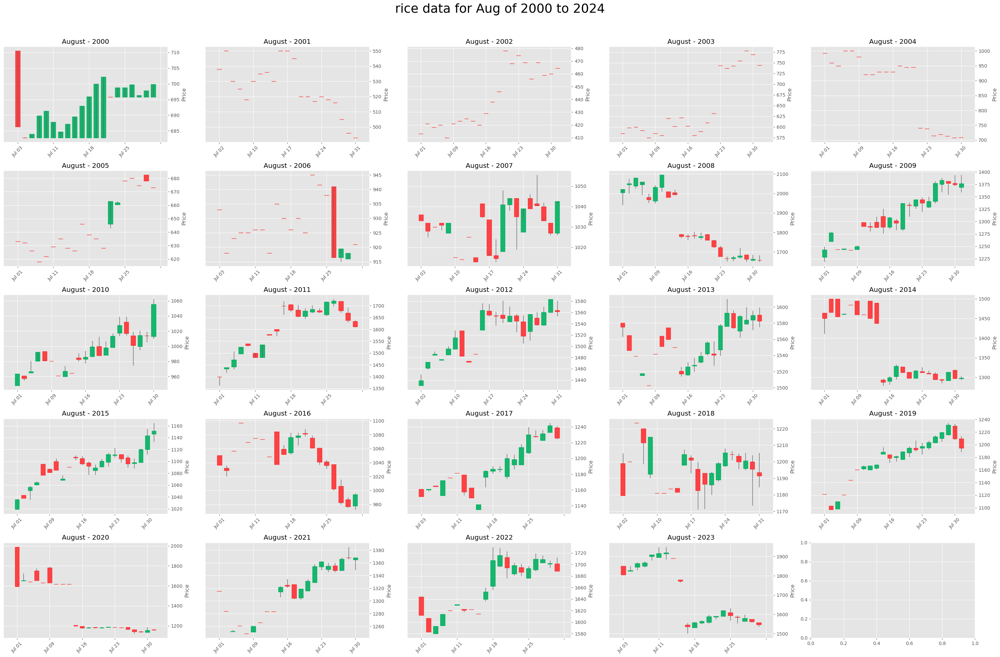

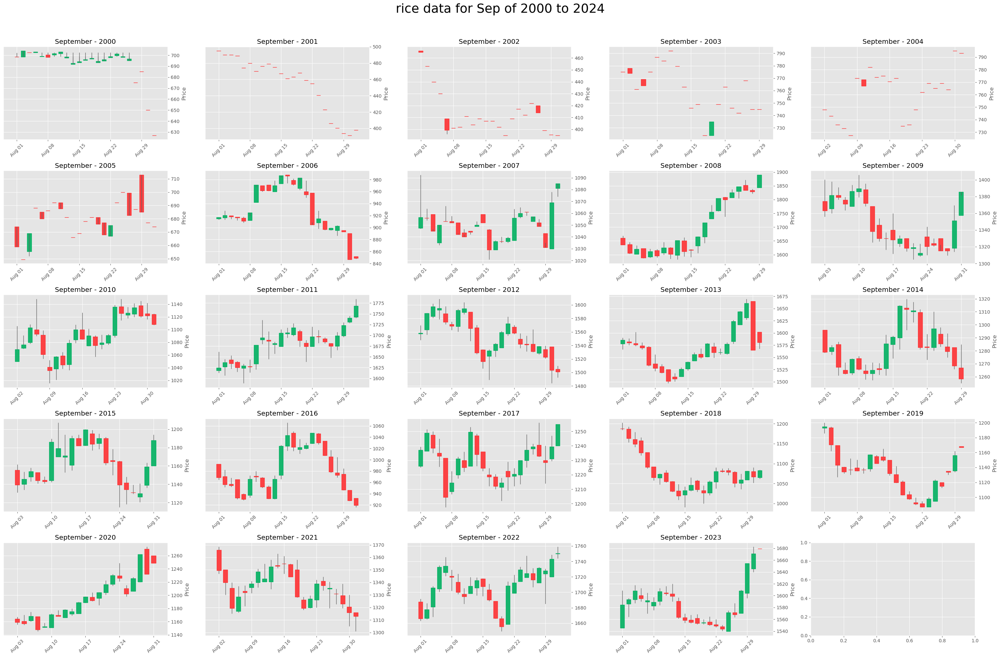

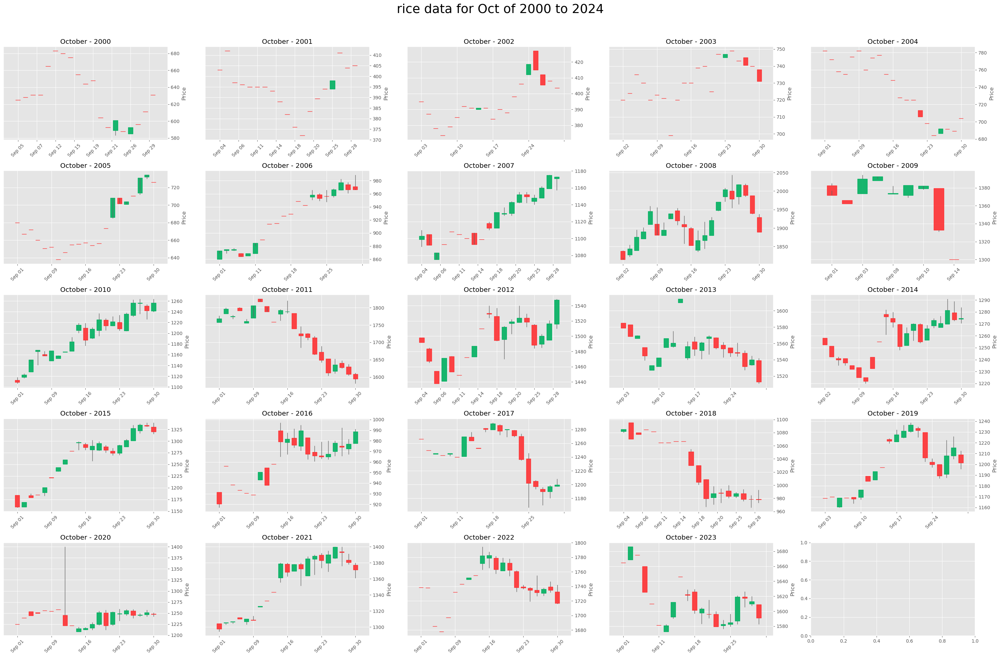

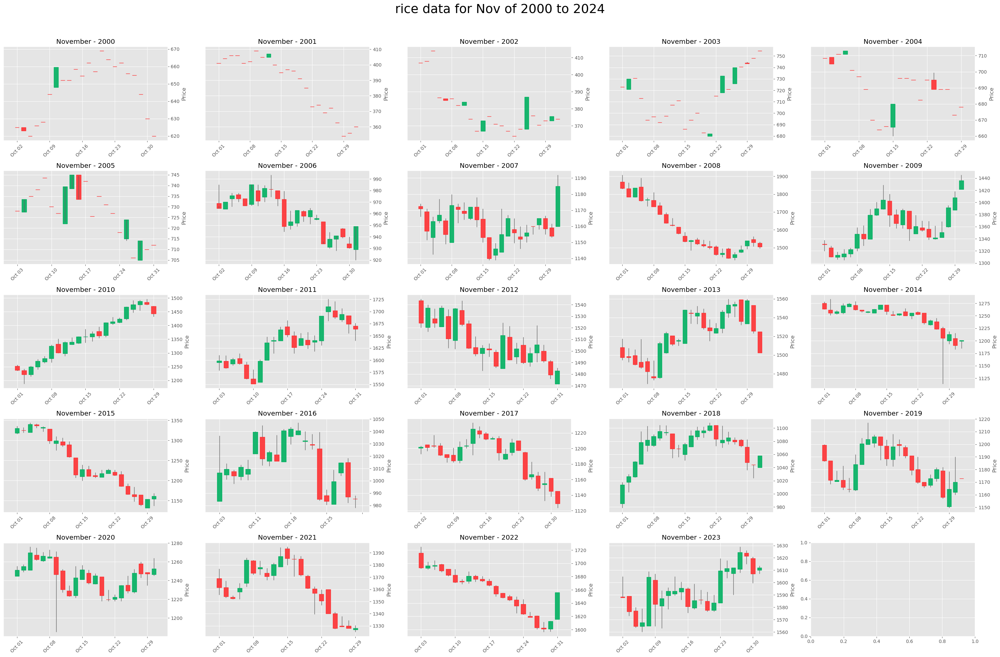

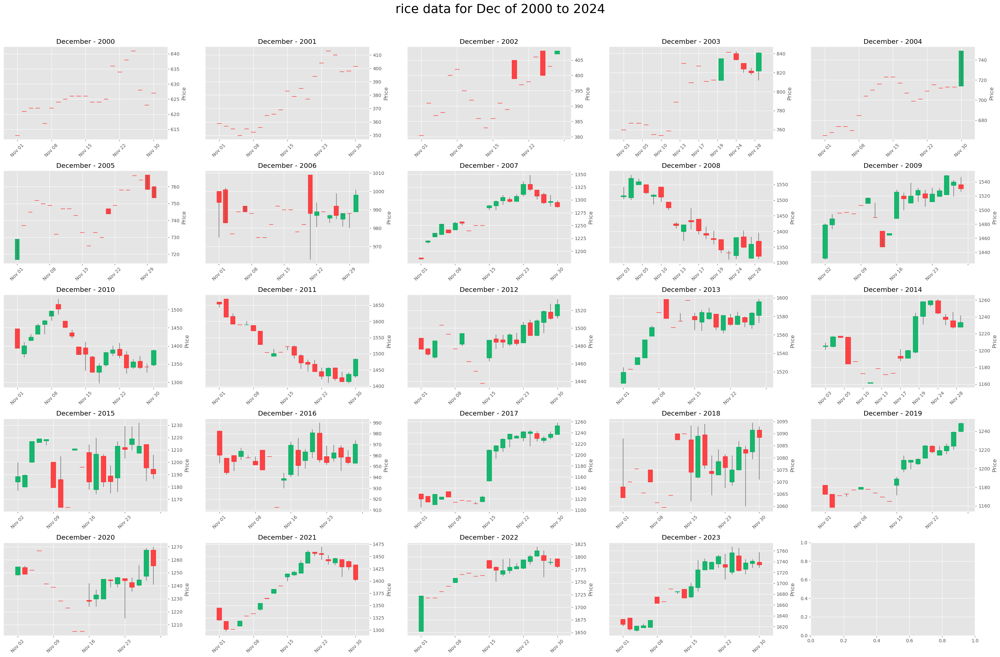

In [18]:
for i in range(len(months)-1):
    plotter_sub_plots(rice_df,i+1,"rice",months[i+1])
    

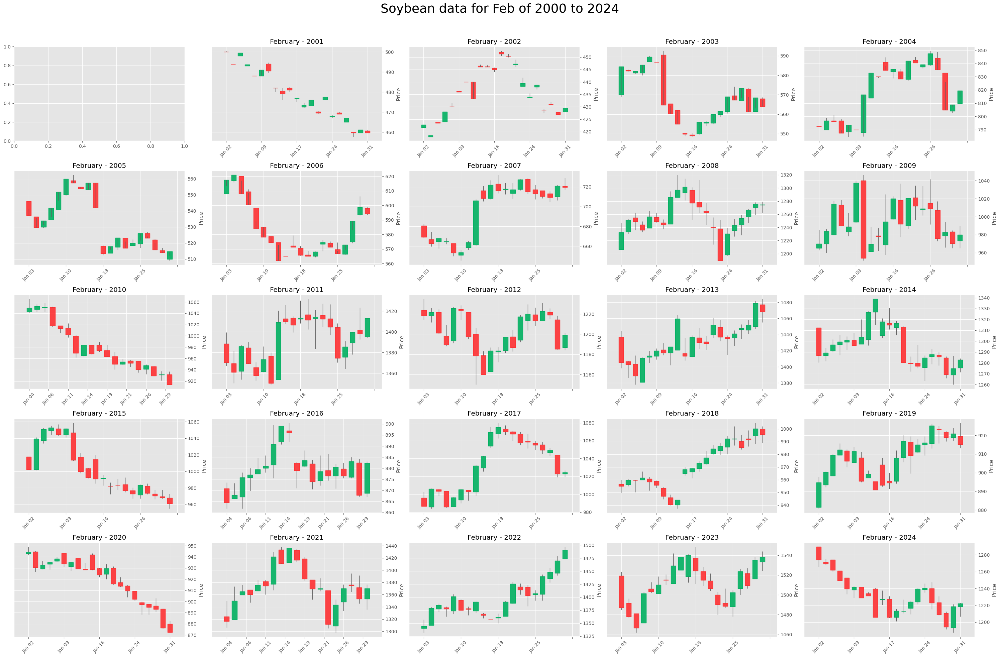

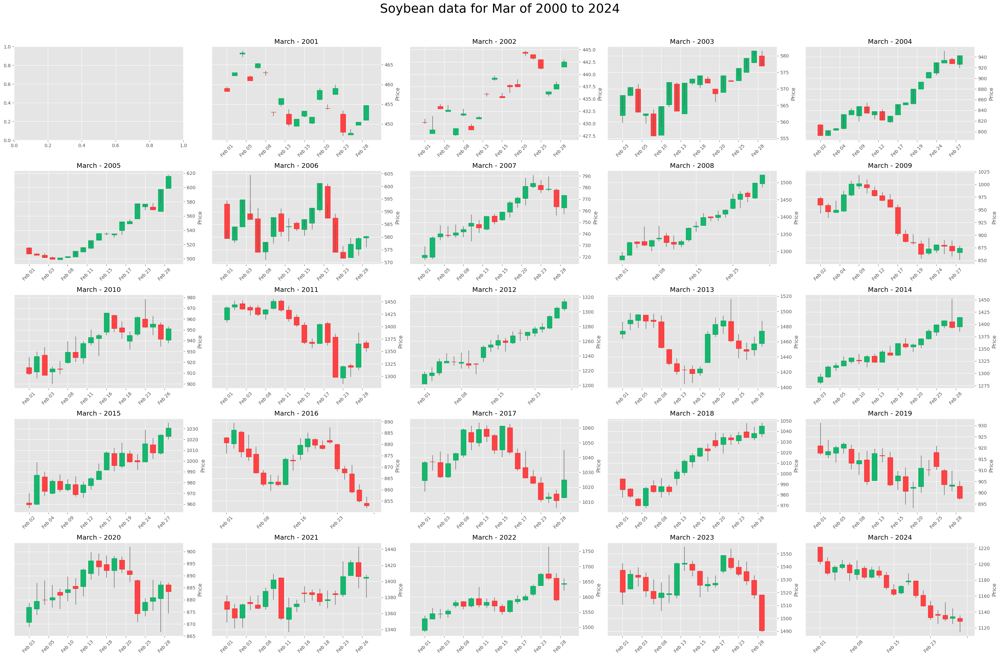

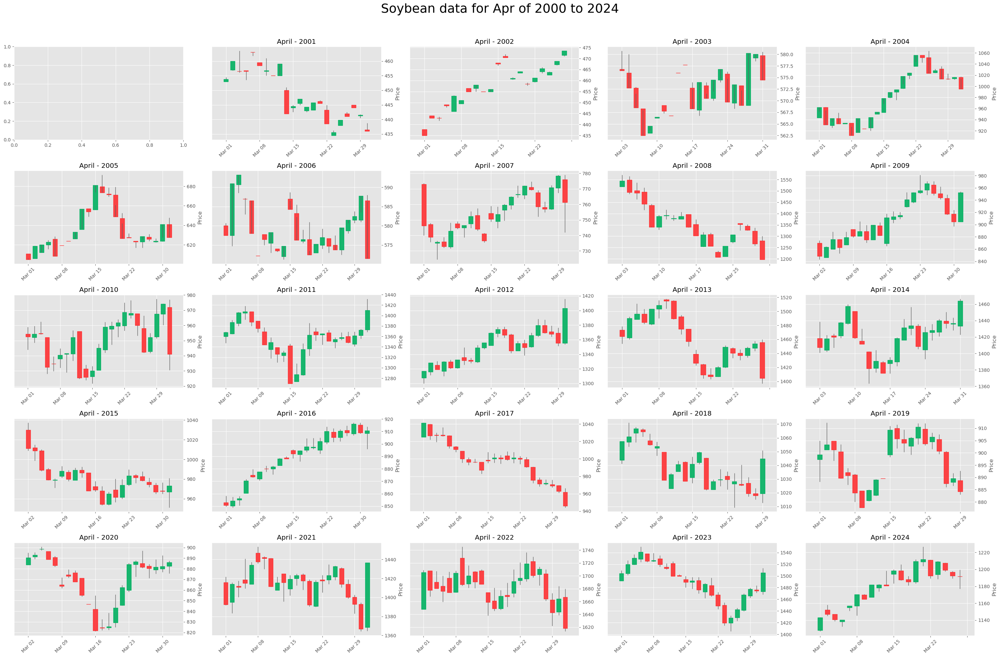

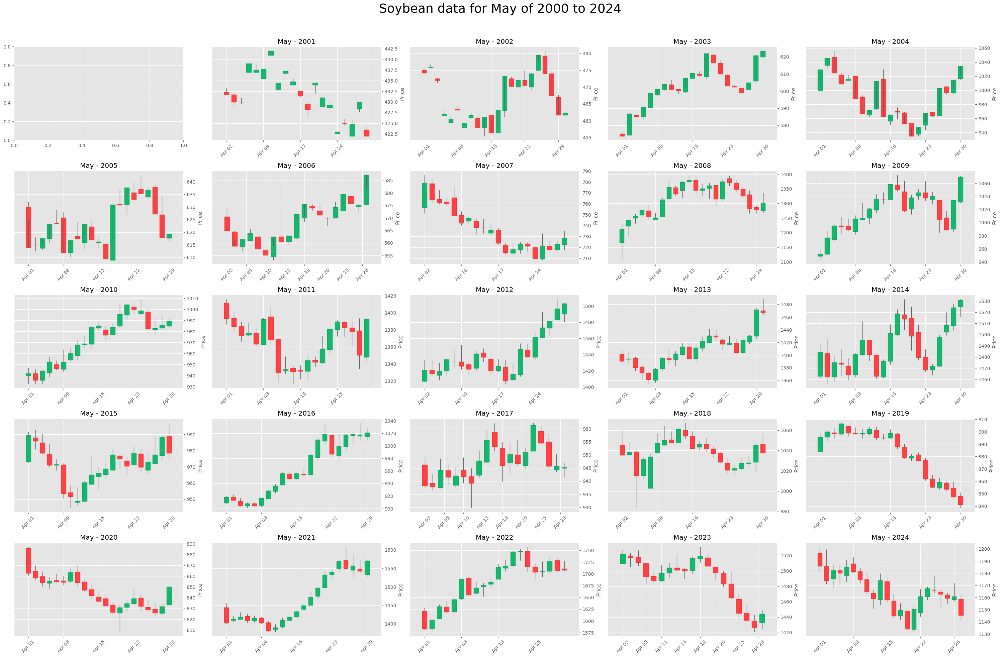

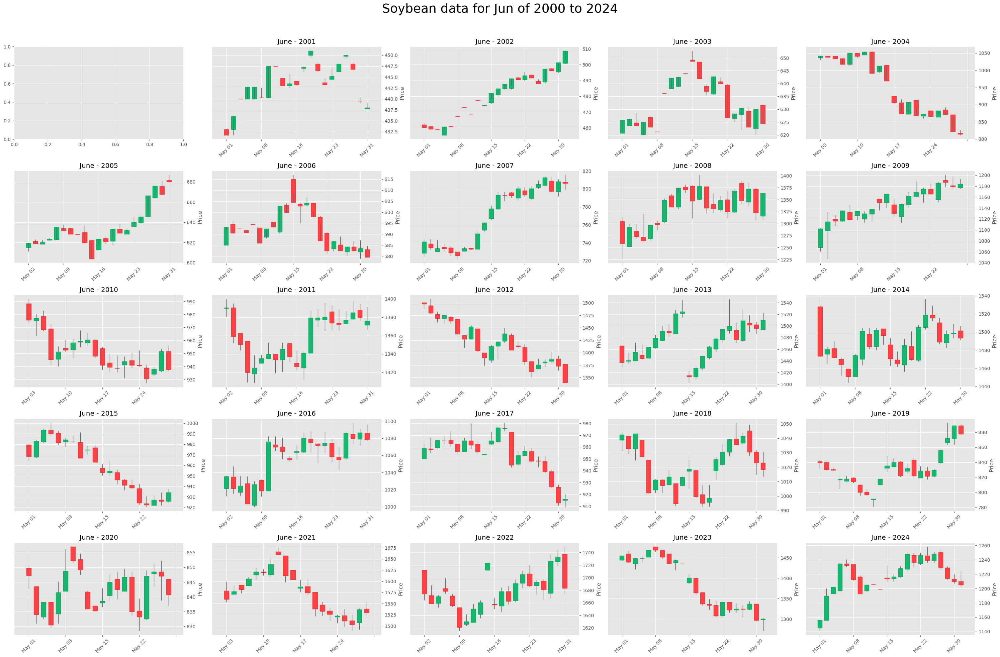

...

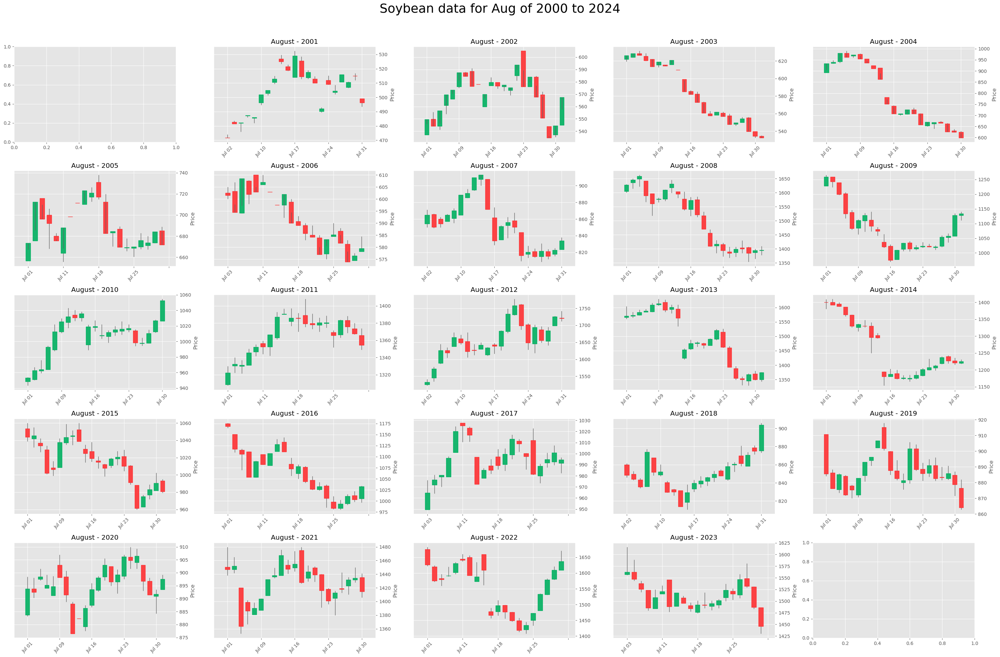

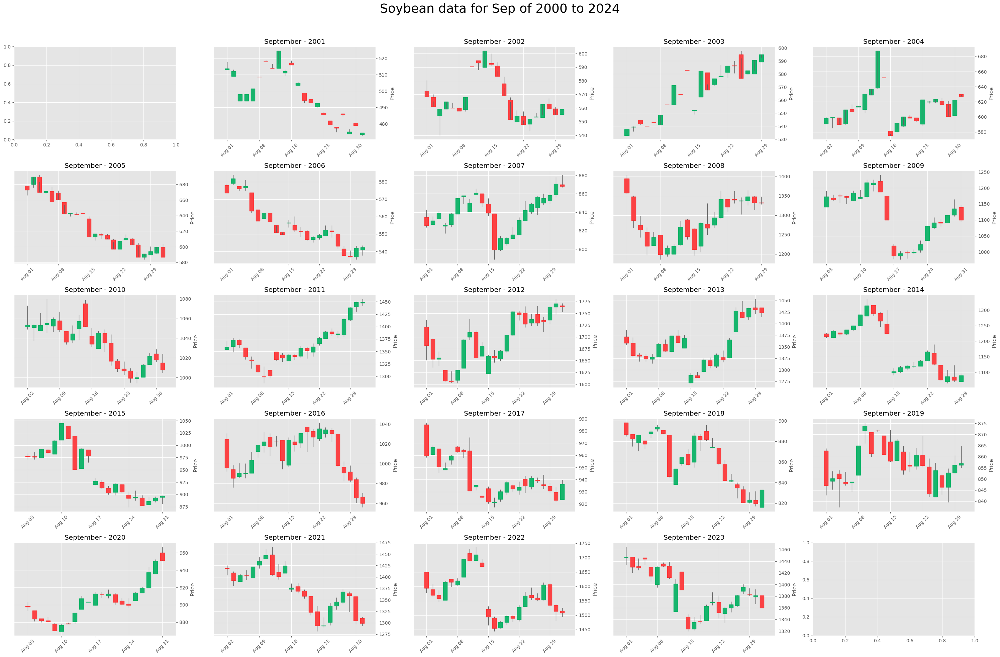

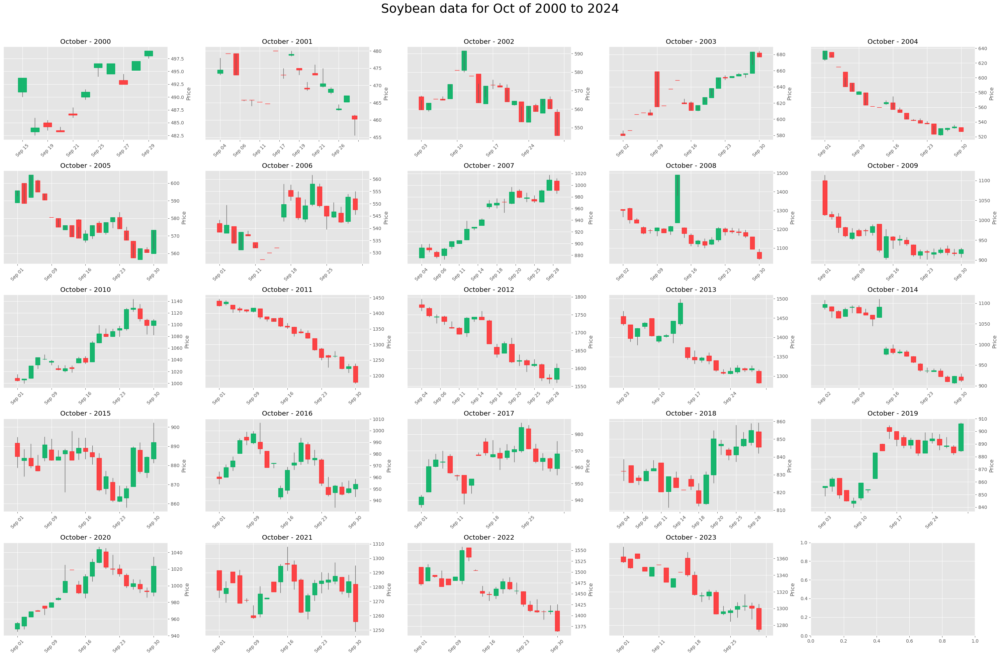

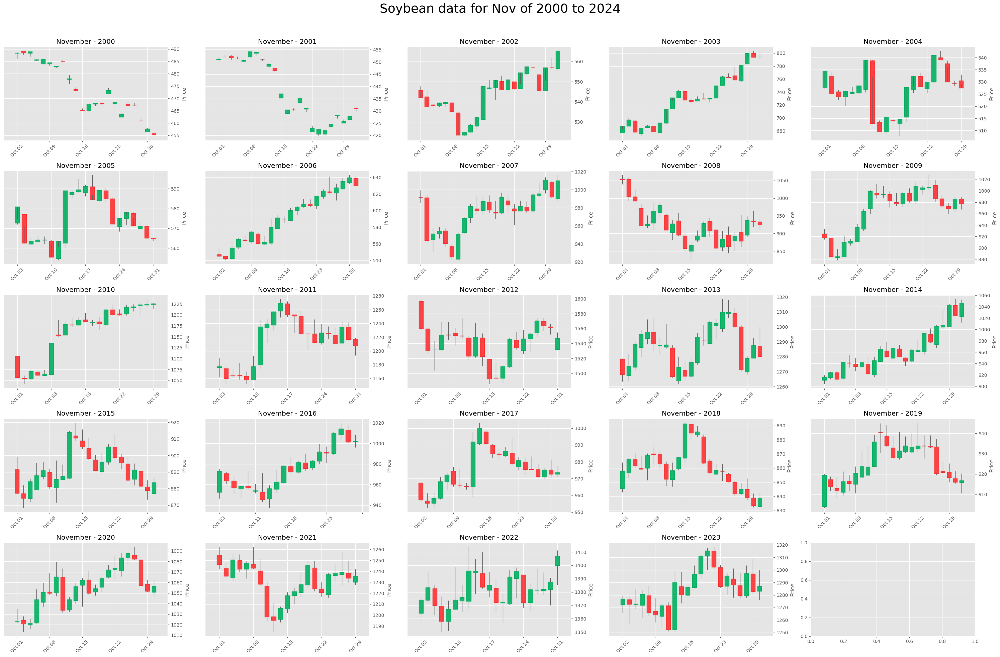

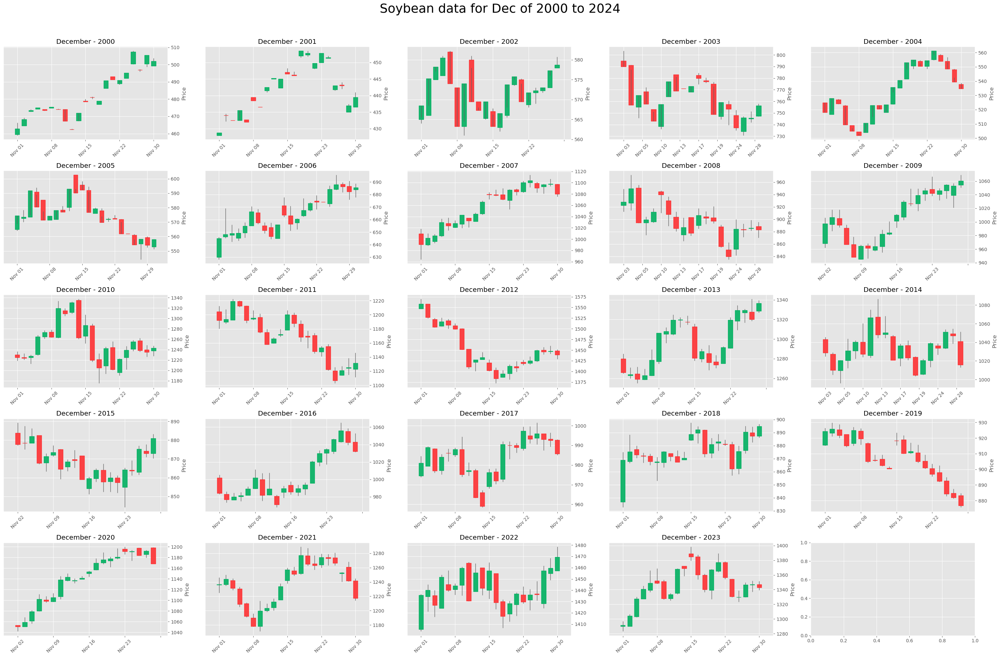

In [19]:
for i in range(len(months)-1):
    plotter_sub_plots(soybean_df,i+1,"Soybean",months[i+1])
    

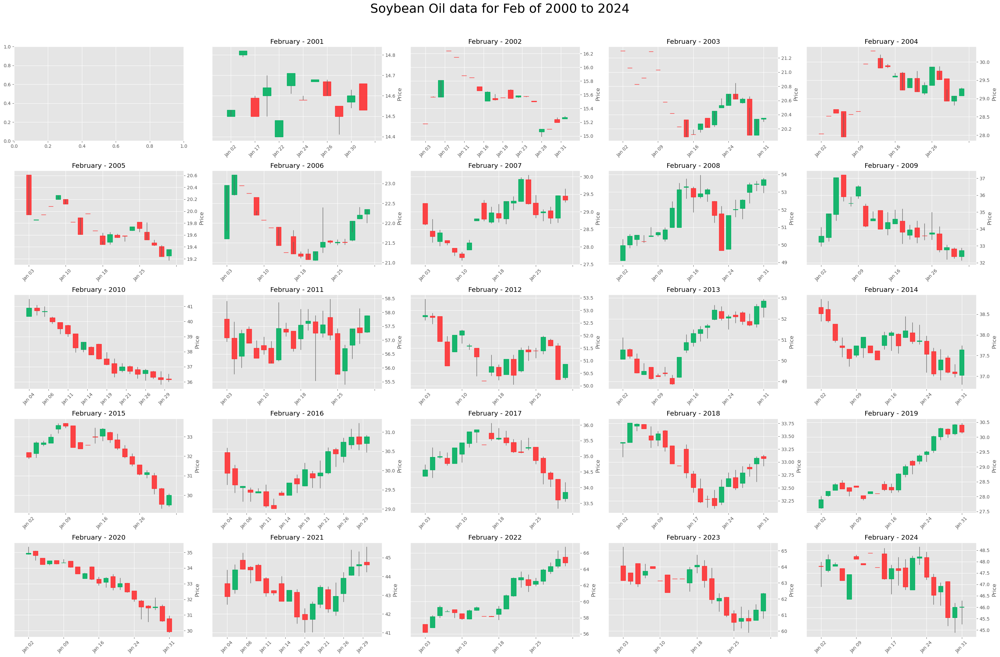

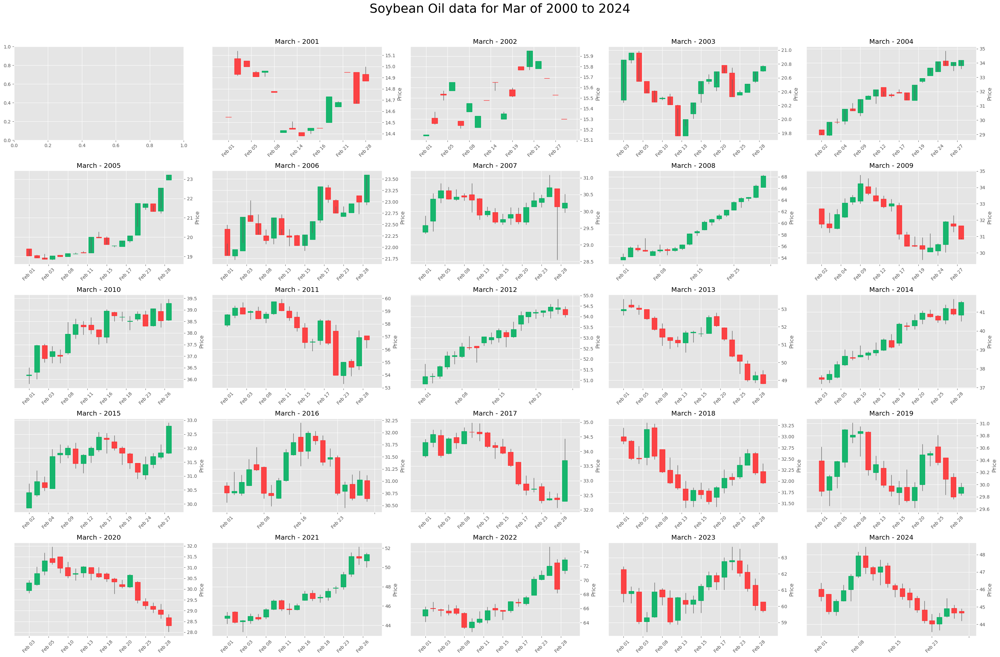

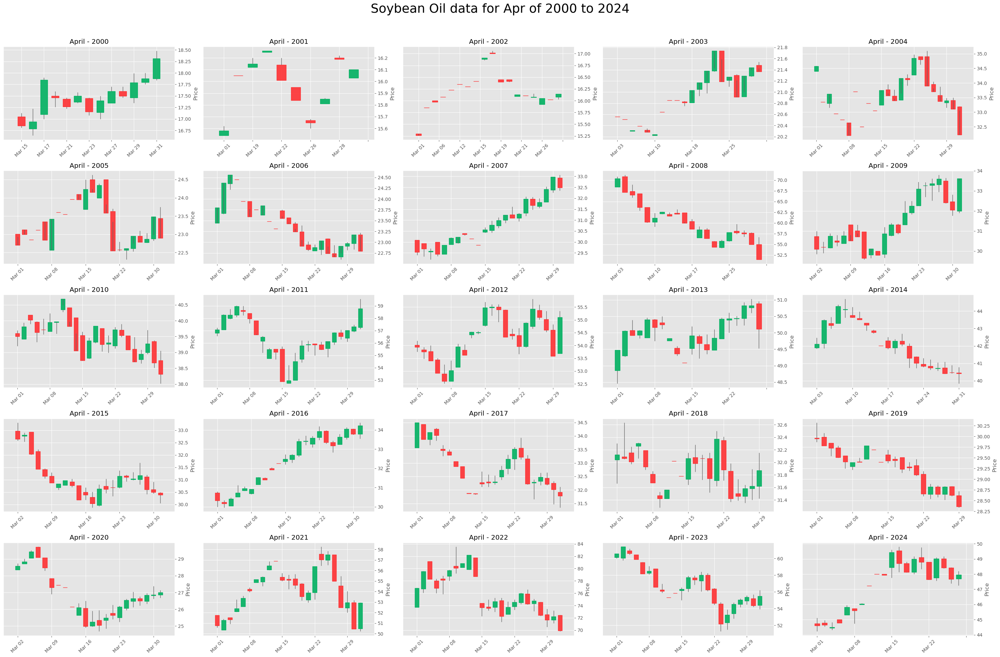

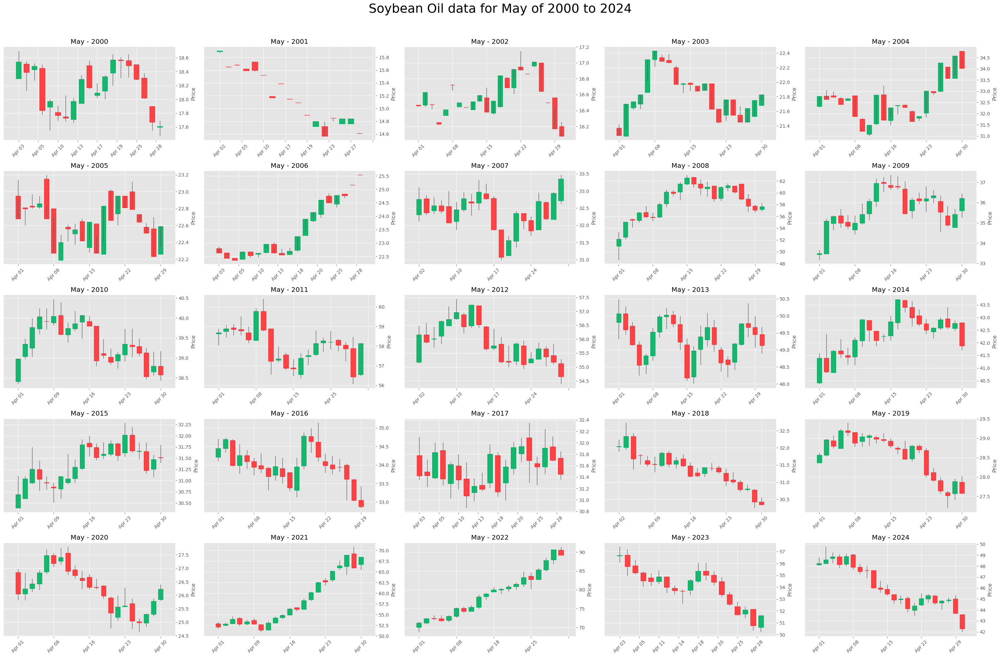

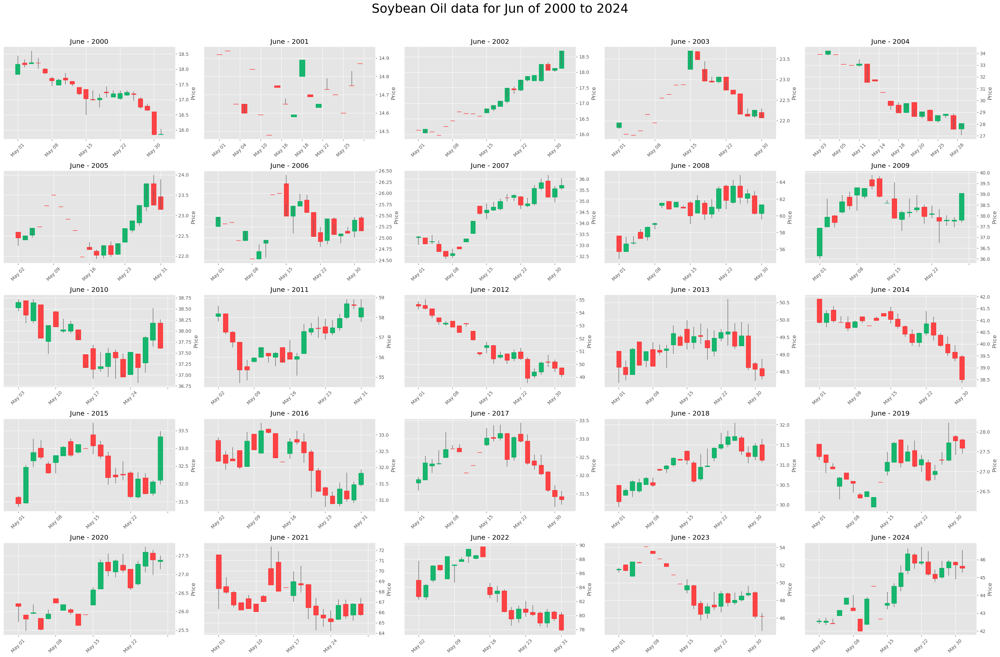

...

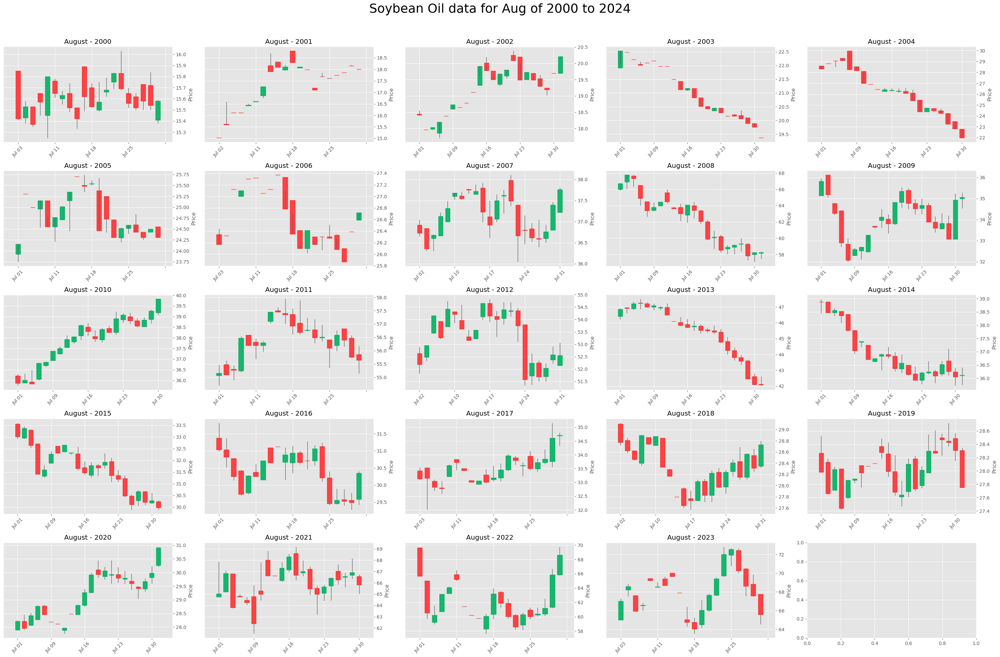

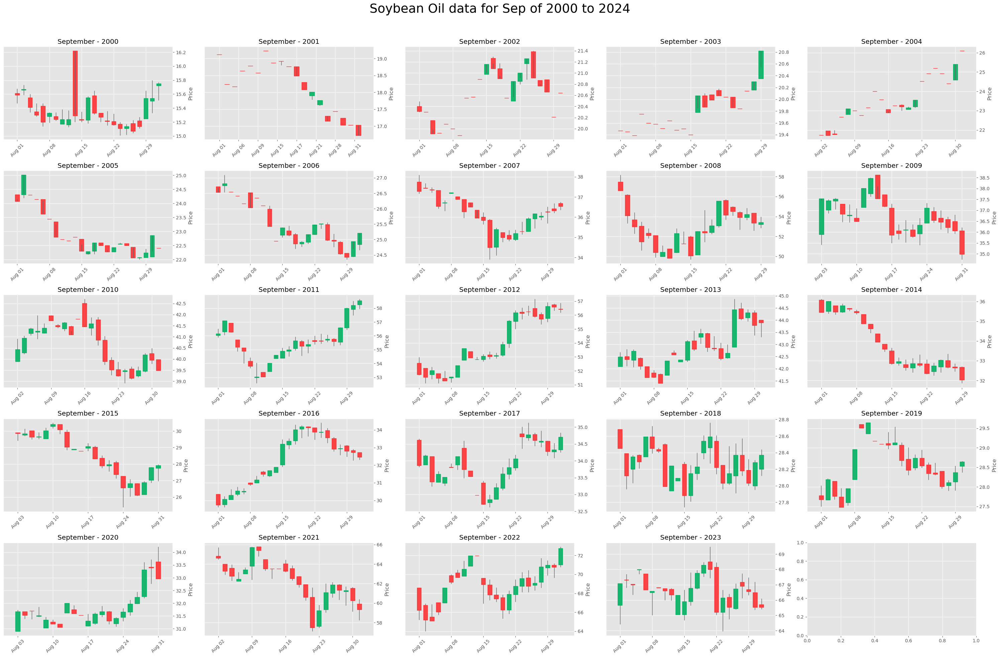

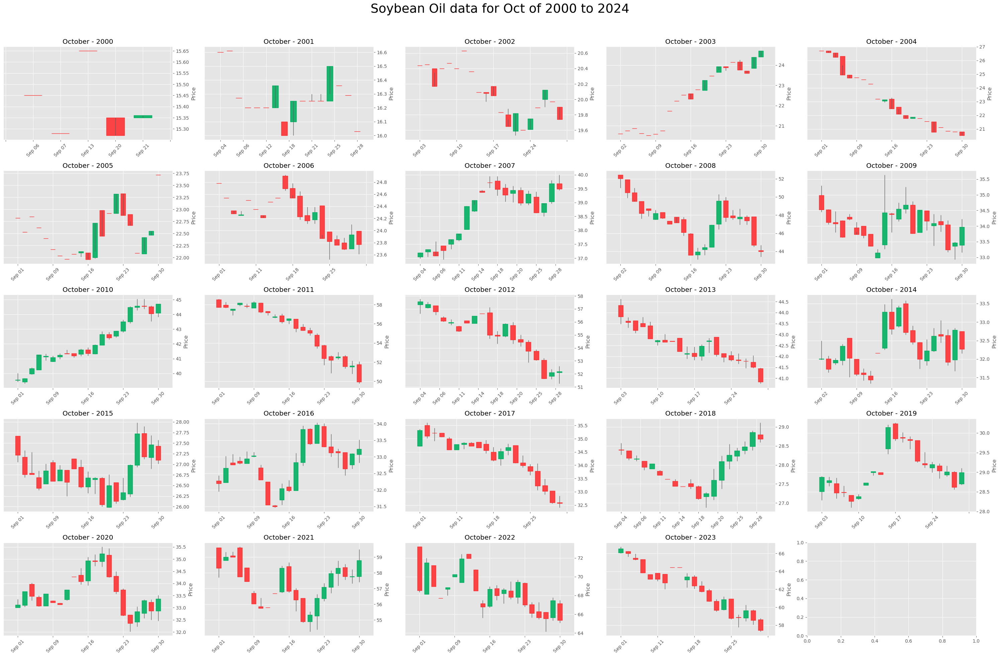

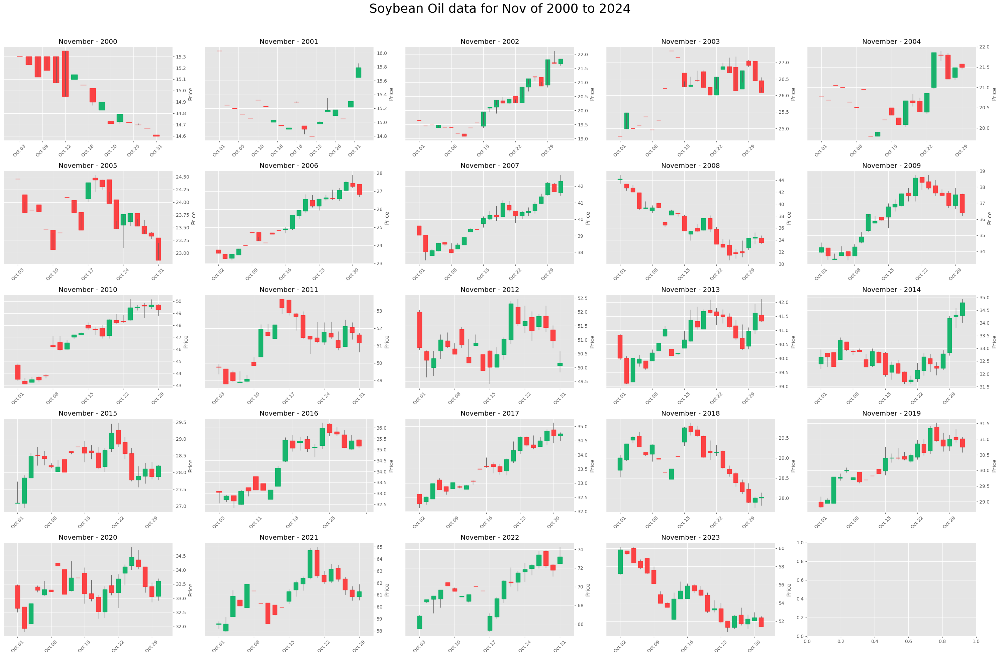

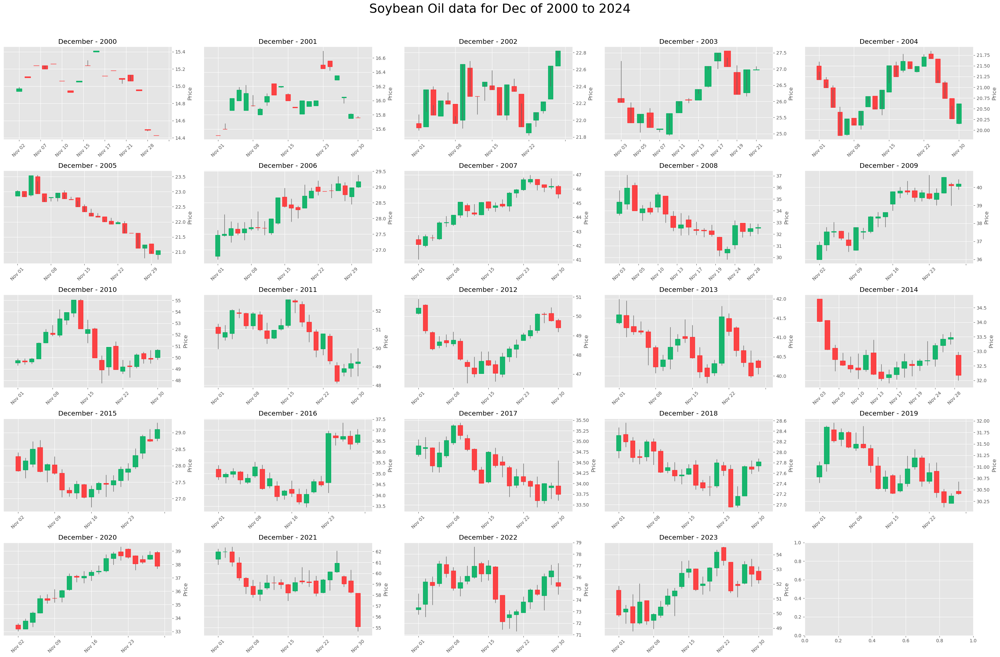

In [20]:
for i in range(len(months)-1):
    plotter_sub_plots(soybean_oil_df,i+1,"Soybean Oil",months[i+1])
    

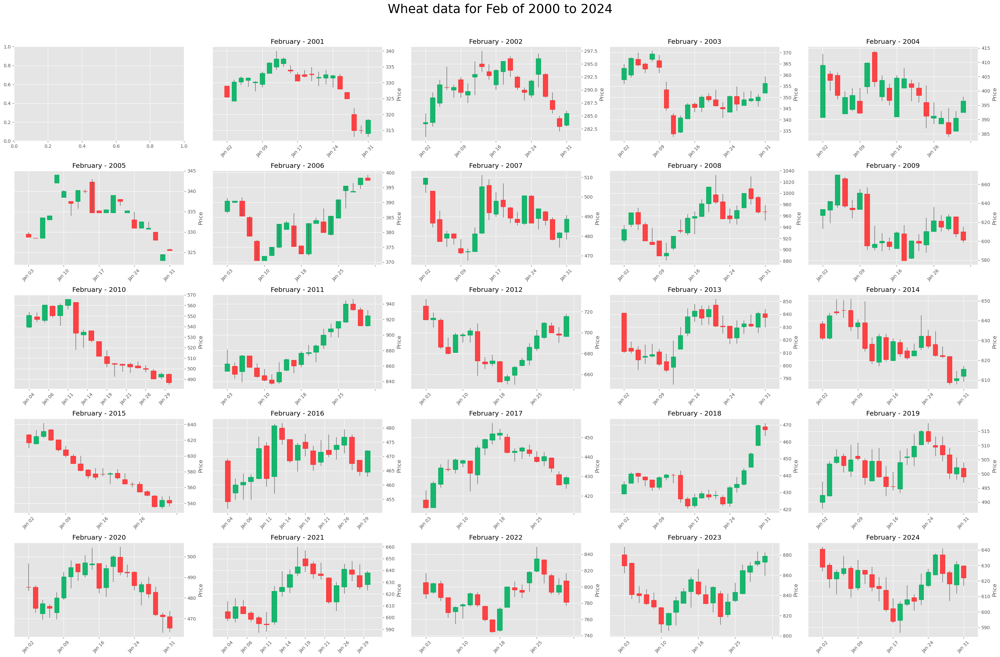

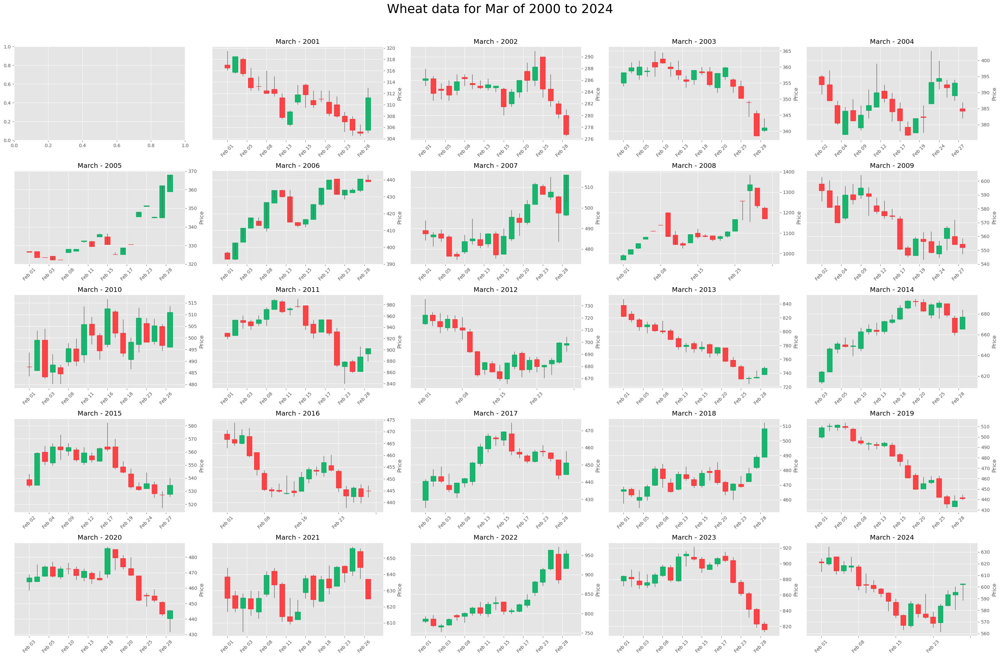

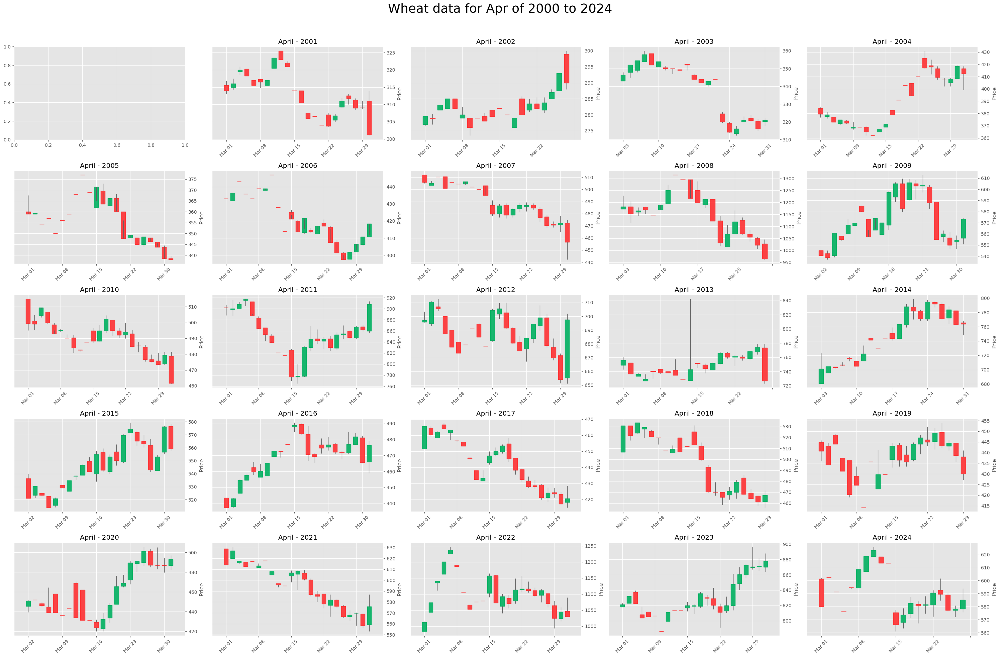

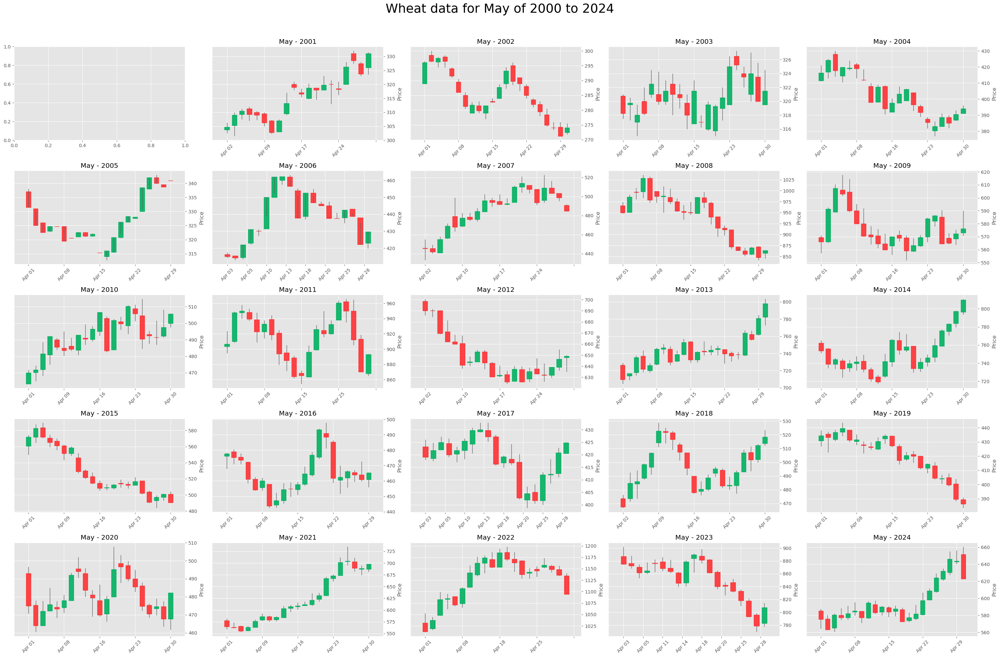

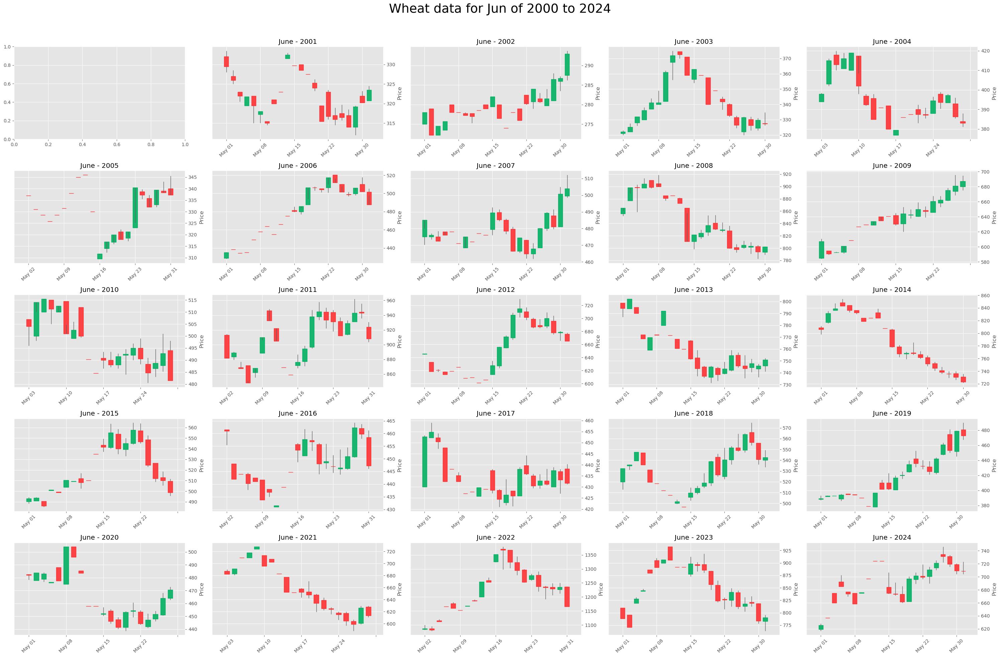

...

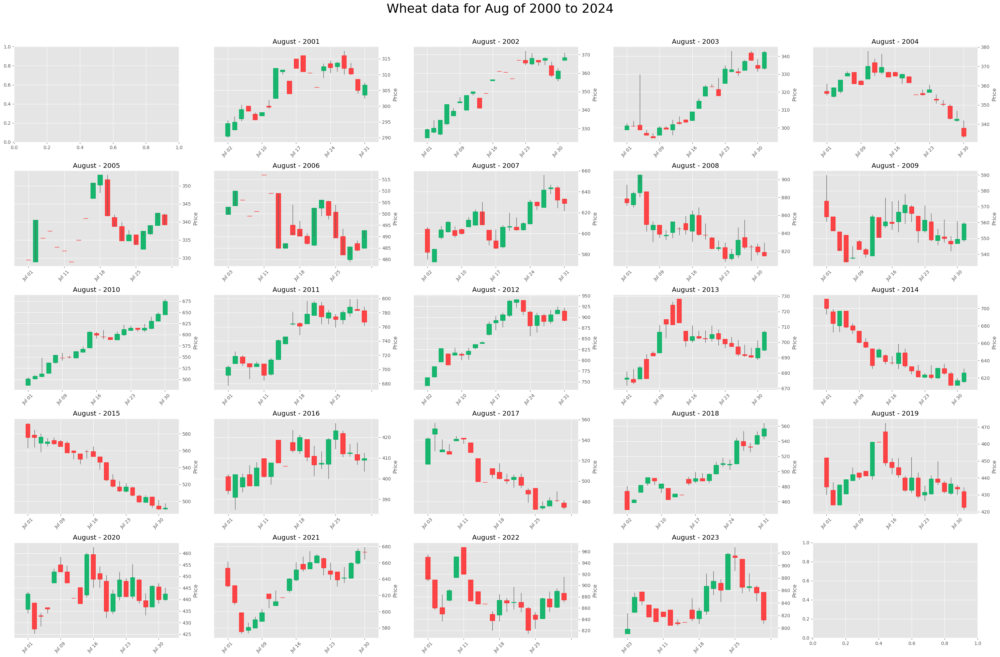

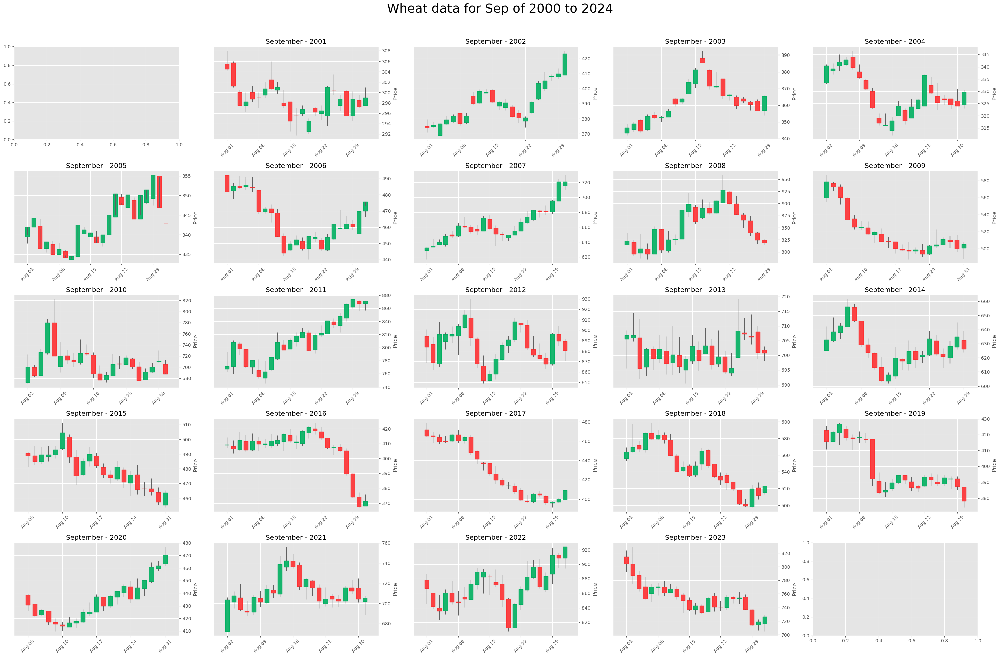

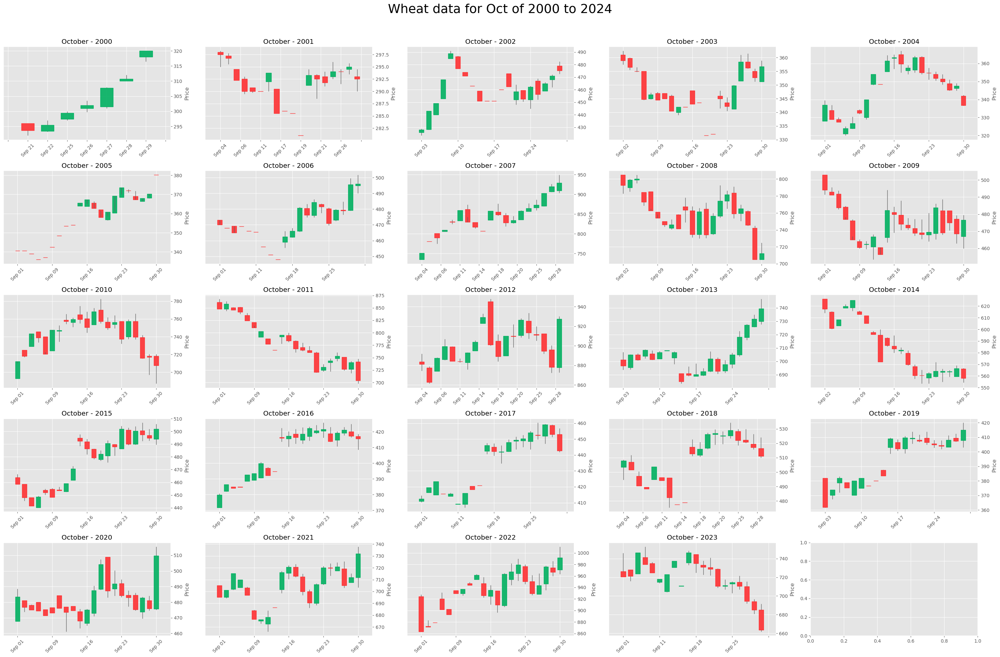

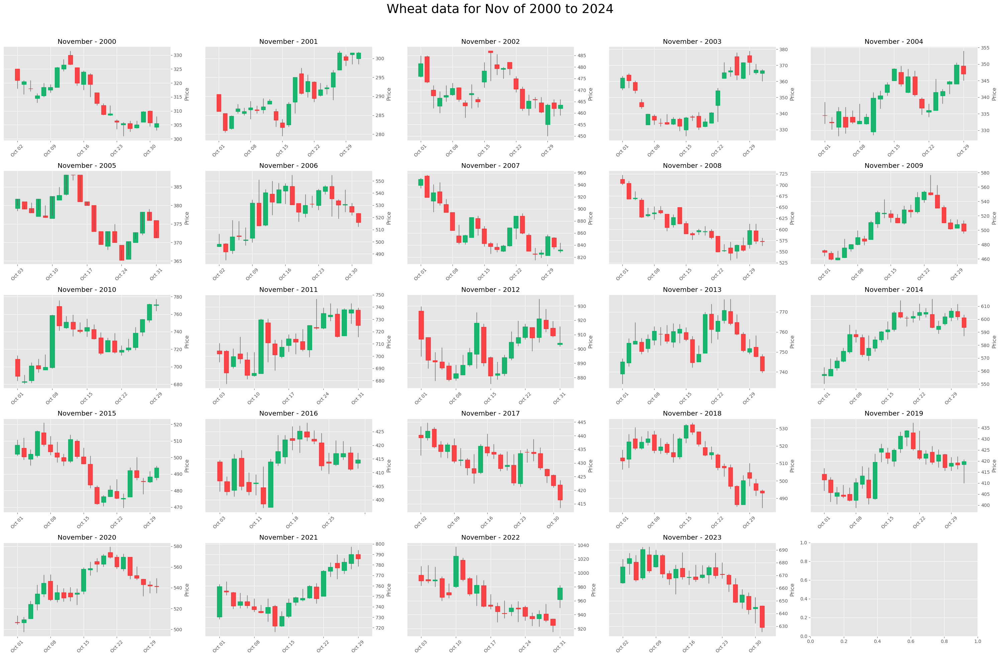

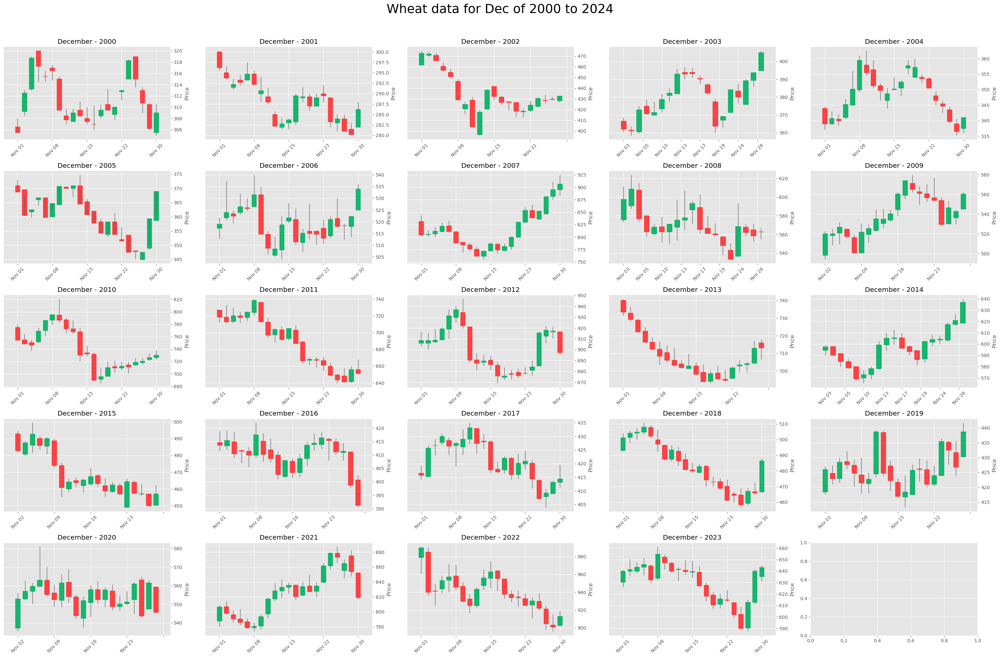

In [21]:
for i in range(len(months)-1):
    plotter_sub_plots(wheat_df,i+1,"Wheat",months[i+1])
    

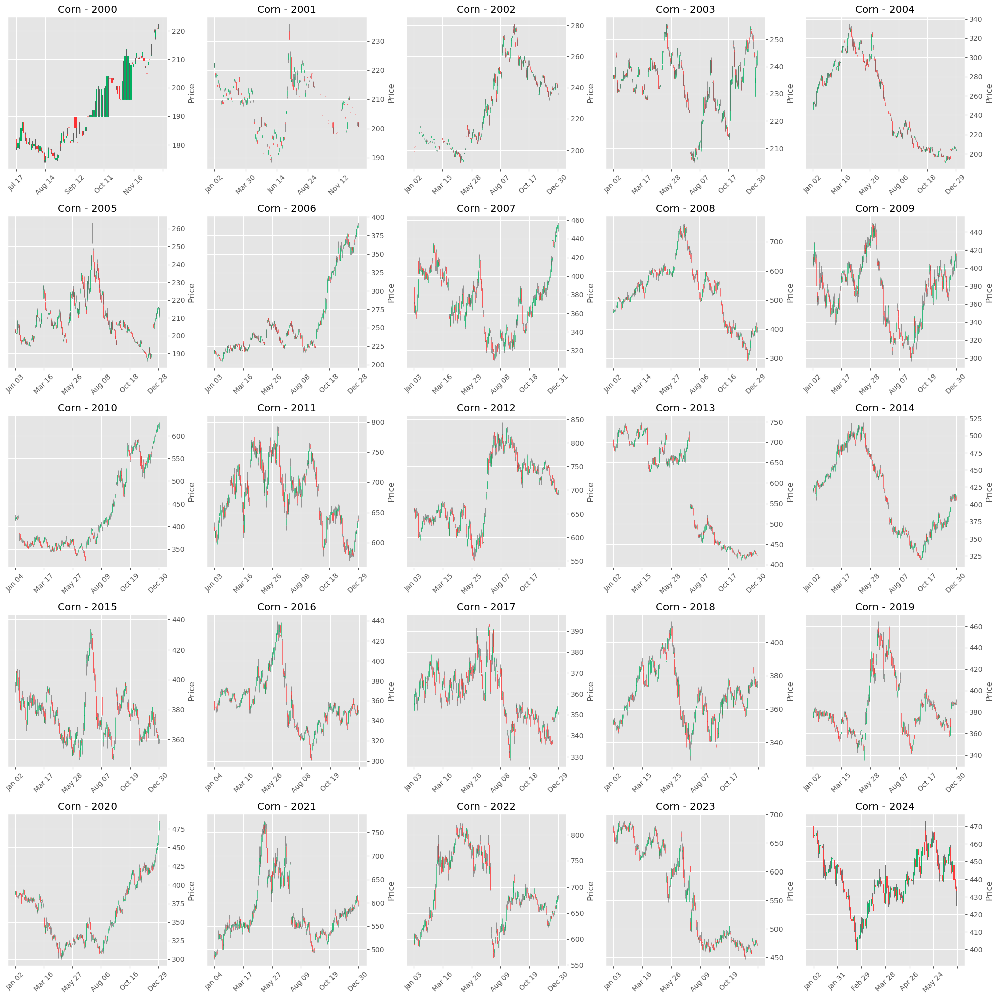

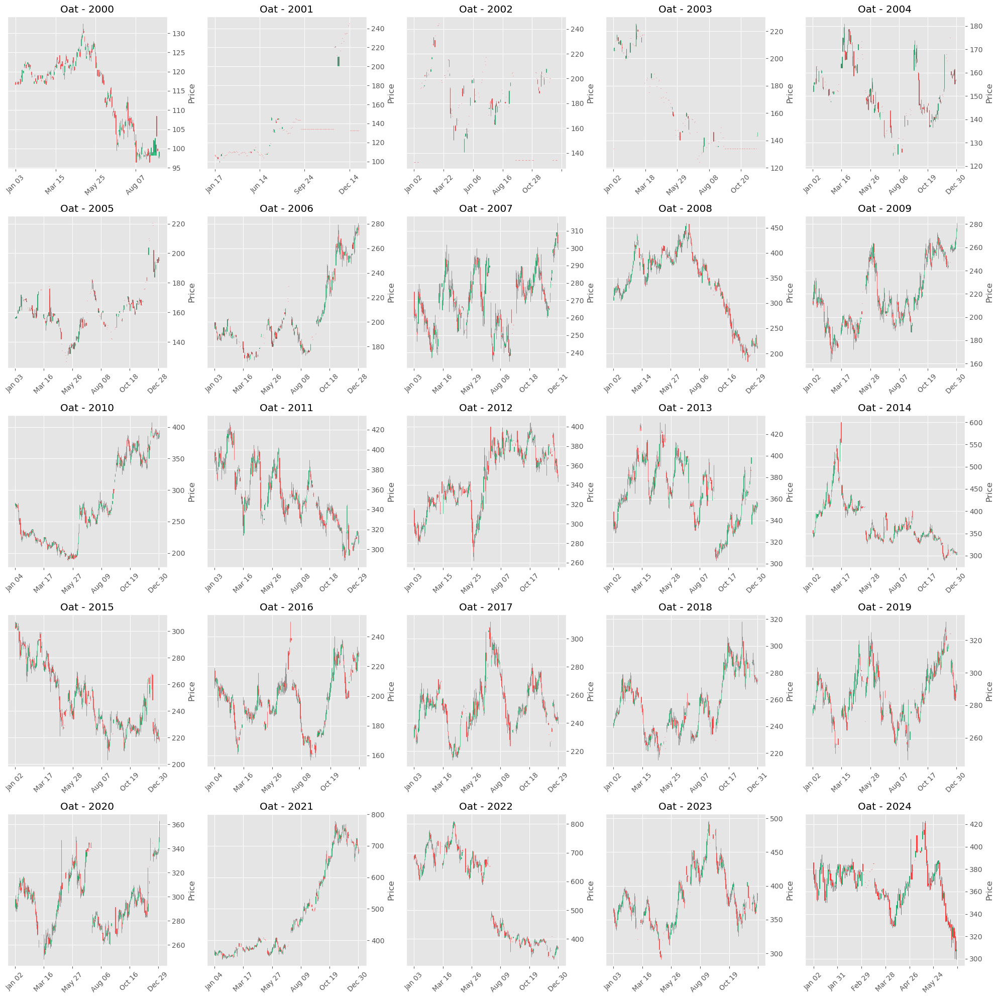

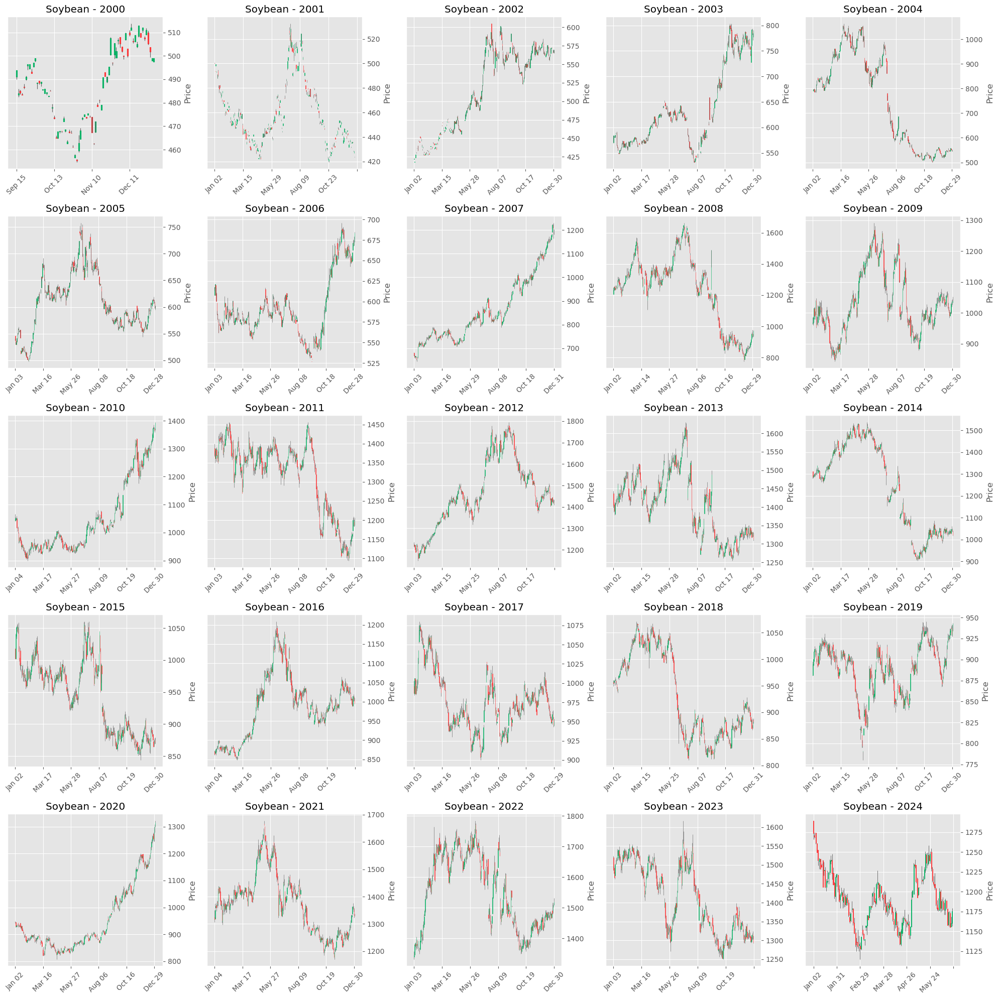

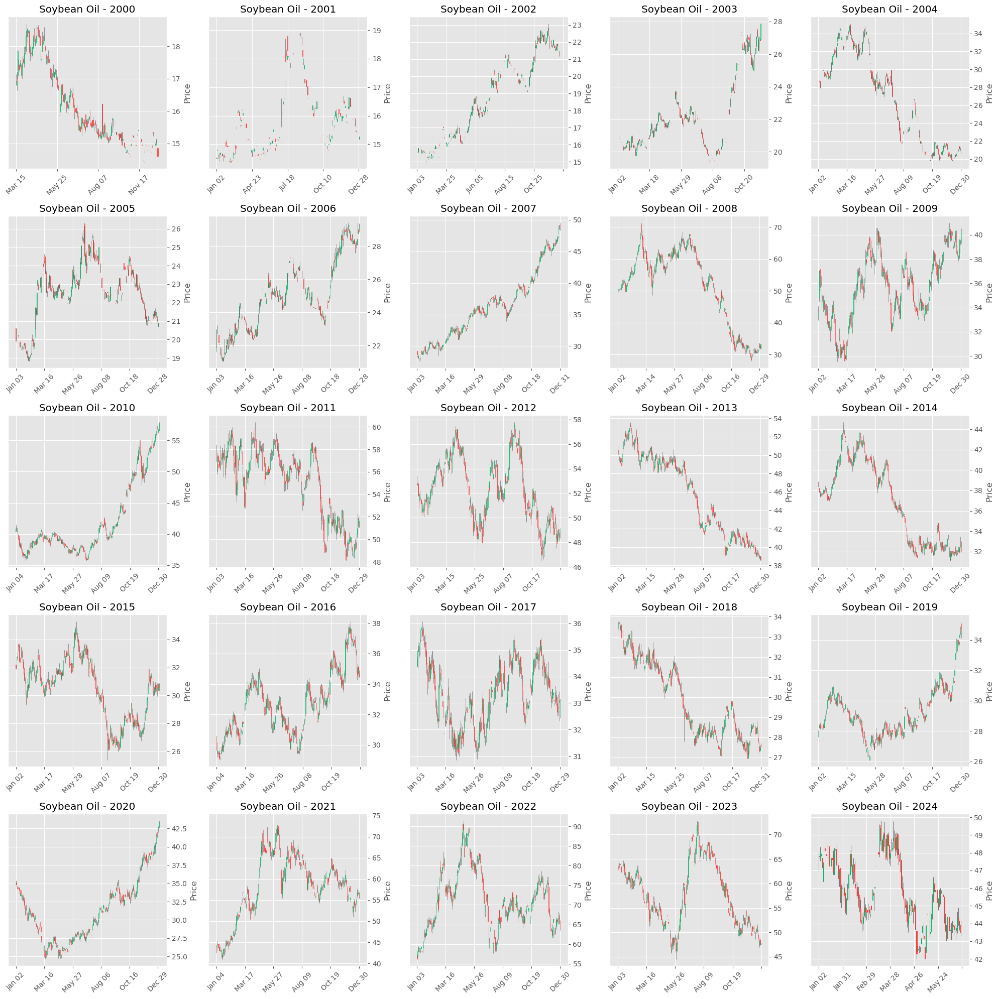

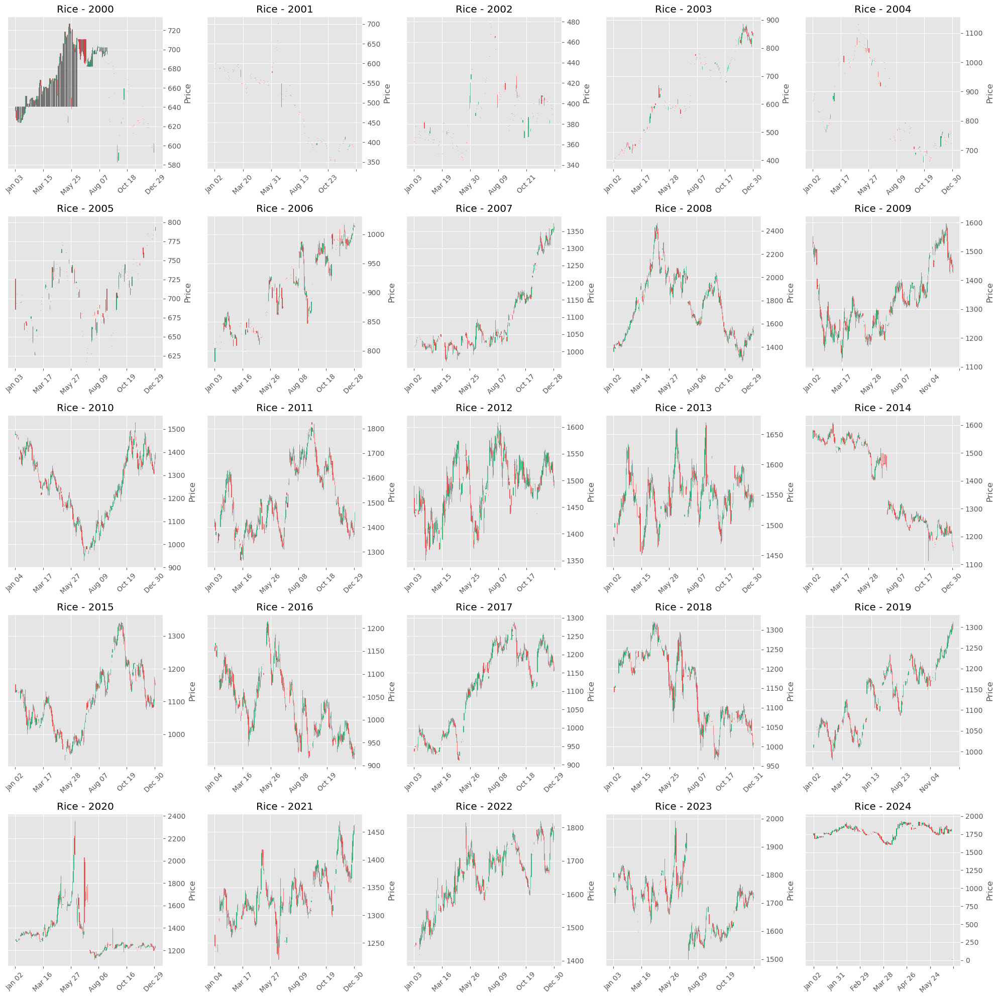

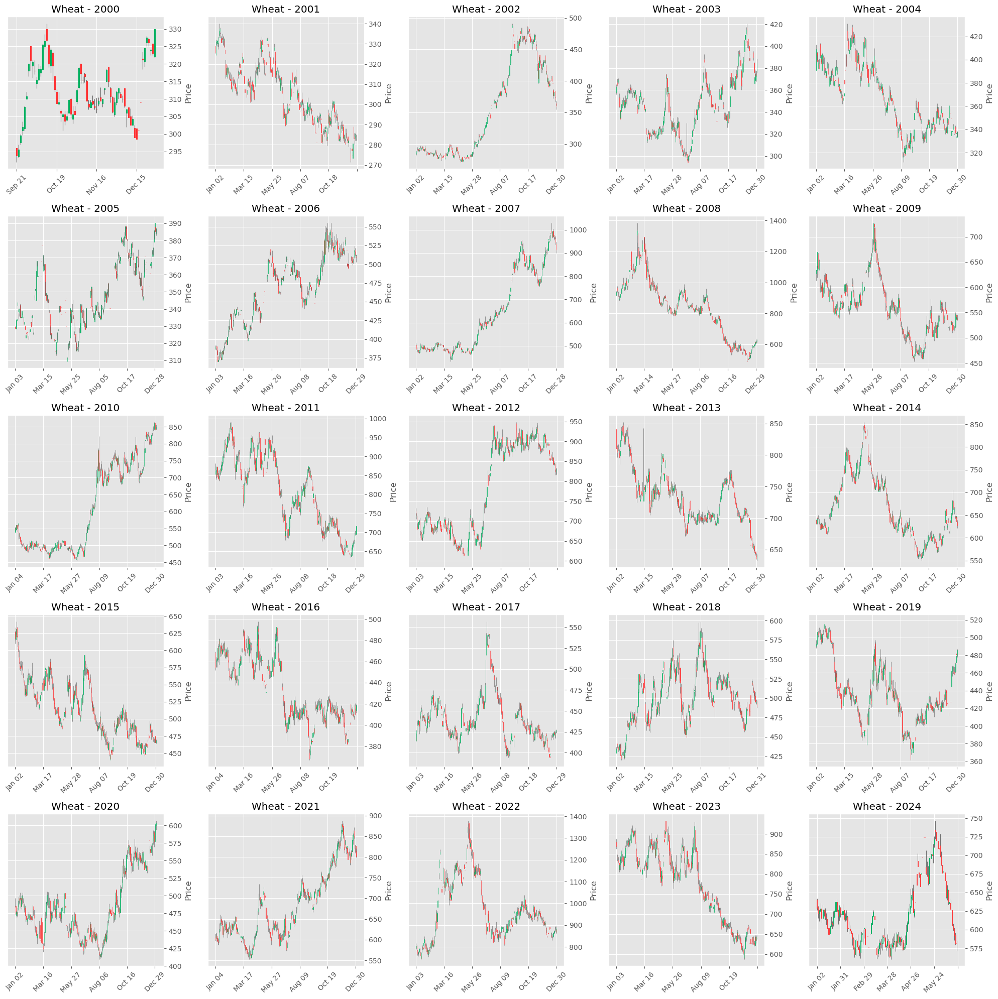

In [22]:
def year_plotter(dfs, titles_names):
    cols = 5  

    for i, df in enumerate(dfs):
        years = df.index.year.unique()
        rows = min(len(years), 5)  
        
        fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 4))
        axes = axes.flatten()

        for j, year in enumerate(years[:25]):  
            df_year = df[df.index.year == year]
            ax = axes[j]  
            mpf.plot(df_year, type='candle', style='yahoo', ax=ax)
            ax.set_title(f'{titles_names[i]} - {year}')  

        for k in range(j + 1, len(axes)):
            fig.delaxes(axes[k])

        plt.tight_layout()
        plt.show()

dfs = [corn_df, oat_df, soybean_df, soybean_oil_df, rice_df, wheat_df]
titles_names = ['Corn', 'Oat', 'Soybean', 'Soybean Oil', 'Rice', 'Wheat']

year_plotter(dfs, titles_names)


In [23]:
all_grains_df.set_index('date',inplace=True)

In [24]:
all_grains_df.drop(columns=['ticker'],inplace=True)

In [25]:
all_grains_df.isna().sum()

commodity    0
open         0
high         0
low          0
close        0
volume       0
dtype: int64

In [26]:
x = [i for i in all_grains_df if i != "commodity"]
for col in x:
    all_grains_df[f'{col}_moving_average'] = all_grains_df.groupby('commodity')[col].transform(lambda x: x.rolling(window=2).mean())


In [27]:
for col in x:
    all_grains_df[f'{col}_rolling_maximum'] = all_grains_df.groupby('commodity')[col].transform(lambda x: x.rolling(window=2).max())


In [28]:
all_grains_df = all_grains_df.dropna()

In [29]:
X = all_grains_df[[i for i in all_grains_df if i != "commodity"]]
y = all_grains_df['commodity']

In [30]:
X.dropna(inplace=True)

C:\Users\moham\AppData\Local\Temp\ipykernel_21816\490656300.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X.dropna(inplace=True)


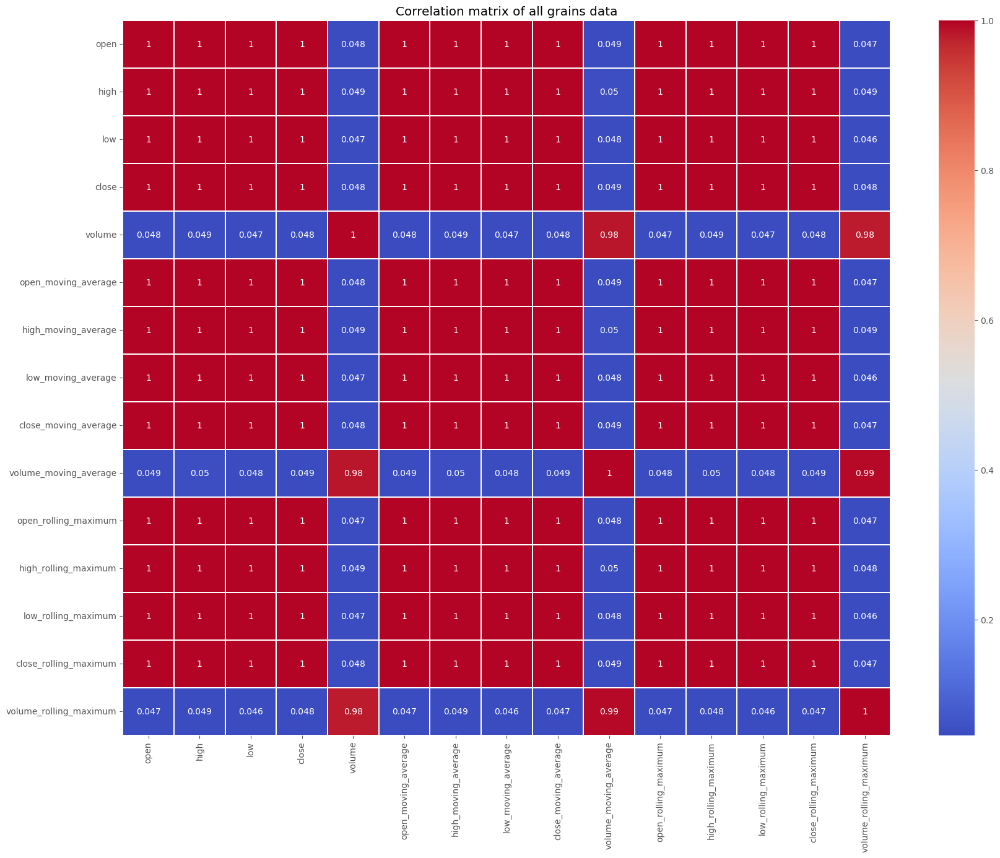

In [31]:
coreelation_matrix = X.corr()
plt.figure(figsize=(20,15))
sns.heatmap(coreelation_matrix,annot=True,cmap='coolwarm',linewidths=0.1)
plt.title("Correlation matrix of all grains data")
plt.show()

In [32]:
labeler = LabelEncoder()
y = labeler.fit_transform(y)


In [33]:
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [34]:
x_train,x_test, y_train, y_test = train_test_split(X,y,test_size= 0.2,random_state=42)

In [35]:
param_grid = {
    'C': [0.1, 1, 10, 100],
    'gamma': ['scale', 'auto'],
    'kernel': ['rbf', 'linear']
}


grid = GridSearchCV(SVC(), param_grid, refit=True, verbose=2)
grid.fit(x_train, y_train)

print("Best Parameters:", grid.best_params_)



Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  25.5s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  20.9s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  22.8s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  20.2s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=  23.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=  10.8s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   9.7s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   9.5s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   9.2s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   9.6s
[CV] END ......................C=0.1, gamma=auto, kernel=rbf; total time=  18.0s
[CV] END ......................C=0.1, gamma=auto

In [36]:
best_model = grid.best_estimator_
y_pred = best_model.predict(x_test)


In [37]:
cls_report = classification_report(y_test,y_pred=y_pred)
con_mtrx = confusion_matrix(y_test,y_pred)

print(cls_report)


              precision    recall  f1-score   support

           0       0.97      0.71      0.82      1211
           1       0.74      0.80      0.77      1227
           2       0.75      0.94      0.84      1180
           3       0.86      0.88      0.87      1225
           4       0.89      0.80      0.84      1178
           5       1.00      1.00      1.00      1186

    accuracy                           0.86      7207
   macro avg       0.87      0.86      0.86      7207
weighted avg       0.87      0.86      0.86      7207



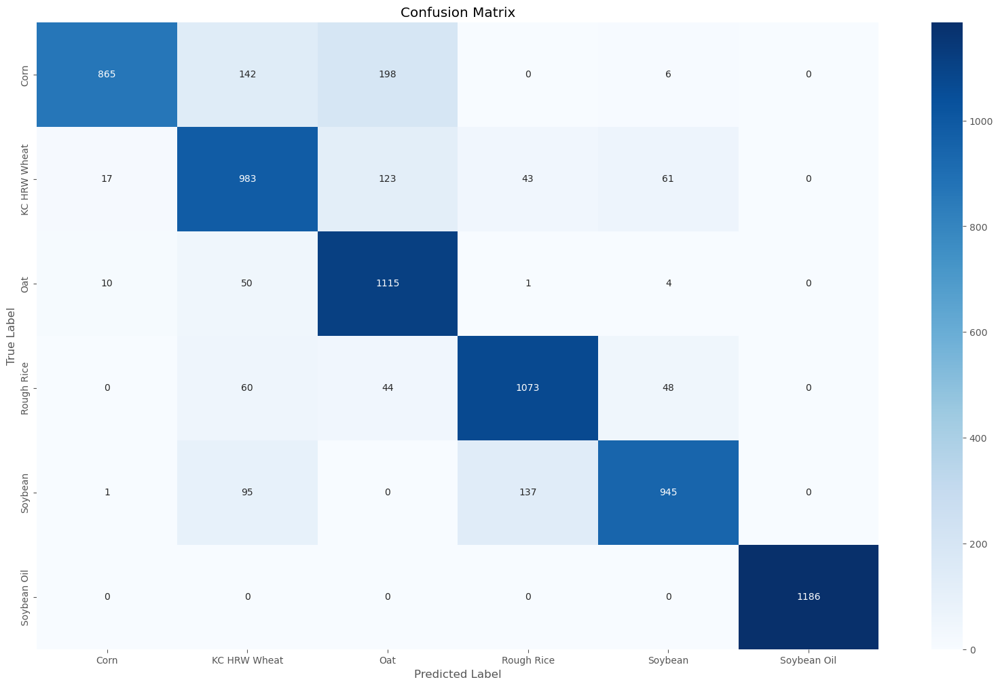

In [38]:
plt.figure(figsize=(20,12))
sns.heatmap(con_mtrx,annot=True,fmt='d',cmap='Blues',xticklabels=labeler.classes_,yticklabels=labeler.classes_)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()